### Goal: Predicit SCD(sudden cardiac death) in patients with HF(heart failure) NYHA 2 or 3 
#### Follow-up period: 4 years
Datasets avaiables in https://physionet.org/content/music-sudden-cardiac-death/1.0.1/

## 1.  Dataset Import

In [35]:
library(readr)
library(dplyr)
subject_info <- read_delim(
  "/Users/brunorocha/Aulas/HEADS/Sem2/LAB/SudDeath/subject-info.csv",
  delim = ";",
  escape_double = FALSE,
  trim_ws = TRUE,
  locale = locale(decimal_mark = ",")  # Key point
)
#summary(subject_info)
head(subject_info,20)

#open in numbers
#write.csv(subject_info, "subject_info_temp.csv", row.names = FALSE)
#system("open subject_info_temp.csv")


New names:
* `Average RR (ms)` -> `Average RR (ms)...67`
* `Average RR (ms)` -> `Average RR (ms)...74`
Rows: 992 Columns: 103
-- Column specification --------------------------------------------------------
Delimiter: ";"
chr  (4): Patient ID, Age, Holter onset (hh:mm:ss), Number of ventricular pr...
dbl (99): Follow-up period from enrollment (days), days_4years, Exit of the ...

i Use `spec()` to retrieve the full column specification for this data.
i Specify the column types or set `show_col_types = FALSE` to quiet this message.


Patient ID,Follow-up period from enrollment (days),days_4years,Exit of the study,Cause of death,Age,Gender (male=1),Weight (kg),Height (cm),Body Mass Index (Kg/m2),...,Angiotensin-II receptor blocker (yes=1),Anticoagulants/antitrombotics (yes=1),Betablockers (yes=1),Digoxin (yes=1),Loop diuretics (yes=1),Spironolactone (yes=1),Statins (yes=1),Hidralazina (yes=1),ACE inhibitor (yes=1),Nitrovasodilator (yes=1)
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
P0001,2065,1460,NA,0,58,1,83,163,31.2,...,0,1,1,1,1,0,0,0,1,0
P0002,2045,1460,NA,0,58,1,74,160,28.9,...,1,1,1,0,0,0,1,0,0,0
P0003,2044,1460,NA,0,69,1,83,174,27.4,...,1,1,1,1,1,0,0,0,0,0
P0004,2044,1460,NA,0,56,0,84,165,30.9,...,1,1,1,0,1,1,0,0,0,0
P0005,2043,1460,NA,0,70,1,97,183,29.0,...,0,1,1,0,1,0,1,0,1,1
P0006,2043,1460,NA,0,70,1,83,165,30.5,...,0,1,1,0,1,1,0,0,1,1
P0007,2042,1460,NA,0,52,1,71,162,27.1,...,0,1,1,0,0,0,1,0,0,0
P0008,257,257,3,3,44,1,114,179,35.6,...,0,1,1,0,1,0,1,0,1,0
P0009,2039,1460,NA,0,64,0,68,155,28.3,...,0,1,1,0,1,0,1,0,1,1


### - Metadatas

In [36]:

subject_info_codes <- read_delim("/Users/brunorocha/Aulas/HEADS/Sem2/LAB/SudDeath/subject-info_codes.csv",delim = ";", escape_double = FALSE, trim_ws = TRUE)
head(subject_info_codes,5)

subject_info_definitions <- read_delim("/Users/brunorocha/Aulas/HEADS/Sem2/LAB/SudDeath/subject-info_definitions.csv",delim = ";", escape_double = FALSE, trim_ws = TRUE)
head(subject_info_definitions,5)

Rows: 80 Columns: 4
-- Column specification --------------------------------------------------------
Delimiter: ";"
chr (4): Variable, Column, Notes, Codes

i Use `spec()` to retrieve the full column specification for this data.
i Specify the column types or set `show_col_types = FALSE` to quiet this message.


Variable,Column,Notes,Codes
<chr>,<chr>,<chr>,<chr>
Exit of the study,D,Cause of exit from the study,0: survivor;
NA,NA,NA,1: lost to follow-up;
NA,NA,NA,2: cardiac transplantation;
NA,NA,NA,3: Death;
NA,NA,NA,According to closing date of the study


Rows: 15 Columns: 3
-- Column specification --------------------------------------------------------
Delimiter: ";"
chr (3): Variable, Column, Definition

i Use `spec()` to retrieve the full column specification for this data.
i Specify the column types or set `show_col_types = FALSE` to quiet this message.


Variable,Column,Definition
<chr>,<chr>,<chr>
NYHA class,K,New York Heart Association classs
ALT o GPT (IU/L),AB,Alanine Aminotransferase or Glutamic Pyruvic Transaminase
AST o GOT (IU/L),AC,Aspartate Aminotransferase or Glutamyl oxaloacetic transaminase
HDL (mmol/L),AJ,High-density lipoprotein cholesterol
LDL (mmol/L),AL,Low Density Lipoprotein Cholesterol


## 2. Data cleaning 

In [37]:

str(subject_info)
## cols to be fixed
cols_to_fix <- c("Age","Number of ventricular premature contractions per hour")
# Substituir "," por "." e converter para numérico
subject_info[cols_to_fix] <- lapply(subject_info[cols_to_fix], function(x) {
  as.numeric(gsub(",", ".", x))
})
#str(subject_info)
problems_age <- subject_info$`Age`[is.na(as.numeric(gsub(",", ".", subject_info$Age)) & !is.na(subject_info$Age))] 
problems_vpc <- subject_info$`Number of ventricular premature contractions per hour`[is.na(as.numeric(gsub(",", ".", subject_info$`Number of ventricular premature contractions per hour`))) & !is.na(subject_info$`Number of ventricular premature contractions per hour`)]
#print(problems_age)
#print(problems_vpc)
# NAs in  "Age" , "Number of ventricular premature contractions per hour"
#sum(is.na(subject_info$Age)) n = 1 
#paciente ID 0167 age: >89
subject_info$Age[which(subject_info$`Patient ID` == "P0167")] <- 90
#sum(is.na(subject_info$Age))

#sum(is.na(subject_info$`Number of ventricular premature contractions per hour`)) # n = 237
summary(subject_info$`Number of ventricular premature contractions per hour`)



spc_tbl_ [992 x 103] (S3: spec_tbl_df/tbl_df/tbl/data.frame)
 $ Patient ID                                           : chr [1:992] "P0001" "P0002" "P0003" "P0004" ...
 $ Follow-up period from enrollment (days)              : num [1:992] 2065 2045 2044 2044 2043 ...
 $ days_4years                                          : num [1:992] 1460 1460 1460 1460 1460 1460 1460 257 1460 1460 ...
 $ Exit of the study                                    : num [1:992] NA NA NA NA NA NA NA 3 NA NA ...
 $ Cause of death                                       : num [1:992] 0 0 0 0 0 0 0 3 0 0 ...
 $ Age                                                  : chr [1:992] "58" "58" "69" "56" ...
 $ Gender (male=1)                                      : num [1:992] 1 1 1 0 1 1 1 1 0 1 ...
 $ Weight (kg)                                          : num [1:992] 83 74 83 84 97 83 71 114 68 88 ...
 $ Height (cm)                                          : num [1:992] 163 160 174 165 183 165 162 179 155 172 ...
 $ Body

Warning message in FUN(X[[i]], ...):
"NAs introduzidos por coerc~ao"
Warning message in FUN(X[[i]], ...):
"NAs introduzidos por coerc~ao"


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
   0.00    0.00    0.00   24.51    0.00 1025.00     237 

### - Removing excluded patients and Defining Target Feature

In [38]:

#count_cause_of_scd <- sum(subject_info$`Cause of death` == 3, na.rm = TRUE)
#count_cause_of_scd # 94 suden death 

#Abandoned
#sum(subject_info$`Exit of the study` == 2, na.rm = TRUE) #20
#transplanted
#sum(subject_info$`Exit of the study` == 1, na.rm = TRUE) - 11

subject_info <- subject_info[!(subject_info$`Exit of the study` %in% c(1, 2)), ]

#count_cause_of_scd <- sum(subject_info$`Cause of death` == 3, na.rm = TRUE) # 94 
#count_cause_of_scd # mantem as 94 suden death 
### creating target if SCD (Sudden Cardiac Death) ,1 else, 0
subject_info$target <- ifelse(subject_info$`Cause of death` == 3, 1, 0)


## 3. Categorical variables - selecting and analysing  (univariate analysis) 

In [39]:

# Categorical Variabels - collecting names in dataset: codes
categ_variables <- subject_info_codes$Variable[!is.na(subject_info_codes$Variable)]
#print(categ_variables)

# Rm "Exit of the study" and "Cause of death" de categ_variables
categ_variables <- categ_variables[categ_variables != "Exit of the study"]
categ_variables <- categ_variables[categ_variables != "Cause of death"]
#print(categ_variables)

# Binary variables - "=1" in name
extra_categ_variables <- names(subject_info)[grepl("=1", names(subject_info)) & !names(subject_info) %in% categ_variables]
# adding others categorical Variabels
categ_variables <- unique(c(categ_variables, extra_categ_variables, "NYHA class", "QRS > 120 ms","Non-sustained ventricular tachycardia (CH>10)"))
print(categ_variables) #39

 [1] "HF etiology - Diagnosis"                       
 [2] "Prior implantable device"                      
 [3] "Prior Revascularization"                       
 [4] "Syncope"                                       
 [5] "Mitral valve insufficiency"                    
 [6] "Mitral flow pattern"                           
 [7] "ECG rhythm"                                    
 [8] "Intraventricular conduction disorder"          
 [9] "Holter  rhythm"                                
[10] "Ventricular Extrasystole"                      
[11] "Ventricular Tachycardia"                       
[12] "Paroxysmal supraventricular tachyarrhythmia"   
[13] "Bradycardia"                                   
[14] "Gender (male=1)"                               
[15] "Diabetes (yes=1)"                              
[16] "History of dyslipemia (yes=1)"                 
[17] "Peripheral vascular disease (yes=1)"           
[18] "History of hypertension (yes=1)"               
[19] "Prior Myocardial Infar

### Statistical Tests for categorical variables - Chi-squared or Fisher 
(Fisher to expecting values < 5)

In [40]:
# vector to  p-values
results <- data.frame(variable = character(), p_value = numeric(), method = character(), stringsAsFactors = FALSE)

# Loop for all categorical variables
for (var in categ_variables) {
  if (var %in% names(subject_info)) {  # Verifica se a variável está no dataset
    tbl <- table(subject_info[[var]], subject_info$target)

    # Fisher to expecting values < 5; others: Chi-squared
    if (any(tbl < 5)) {  
      test_result <- fisher.test(tbl, simulate.p.value = TRUE)  # Usar simulação para p-valor
      method_used <- "Fisher"
    } else {  
      test_result <- chisq.test(tbl)
      method_used <- "Chi-squared"
    }
    
    results <- rbind(results, data.frame(variable = var, p_value = test_result$p.value, method = method_used, stringsAsFactors = FALSE))
  }
}

# Sort results by p-value
results <- results[order(results$p_value), ]
results

Warning message in chisq.test(tbl):
"Aproximac~ao do qui-quadrado pode estar incorreta"


,variable,p_value,method
,<chr>,<dbl>,<chr>
20,Signs of pulmonary venous hypertension (yes=1),0.0000541070,Chi-squared
22,"Q-waves (necrosis, yes=1)",0.0005138569,Chi-squared
39,Non-sustained ventricular tachycardia (CH>10),0.0008153034,Chi-squared
19,Prior Myocardial Infarction (yes=1),0.0008522053,Chi-squared
32,Spironolactone (yes=1),0.0017887849,Chi-squared
11,Ventricular Tachycardia,0.0054972514,Fisher
21,Right ventricle contractility (altered=1),0.0081115497,Chi-squared
37,NYHA class,0.0112480501,Chi-squared
8,Intraventricular conduction disorder,0.0139930035,Fisher


### Filtering by statistical (p < 0.05) and clinical criteria 

In [41]:

#sum(results$p_value < 0.05)#10 or 11  
#sum(results$p_value >= 0.05)# 28 or 29
#separando os sig dos não sig
Results_sig <- results[results$p_value < 0.05, ]      # p < 0.05 (significativo)
print("Signicant")
Results_sig
Results_nsig <- results[results$p_value >= 0.05, ]    # p >= 0.05 (não significativo)
print(" Not Signicant")
Results_nsig

variaveis_sig <- Results_sig$variable

### add by clinical criteria #7 
# HF etiology - Diagnosis, Amiodarone (yes=1);Betablockers (yes=1);"Prior implantable device" ; Calcium channel blocker (yes=1) 
#Gender (male=1) 0.05882051; 

categorical_chosen <- c(as.character(variaveis_sig), 
                   "HF etiology - Diagnosis", 
                   "Amiodarone (yes=1)",
                   "Prior implantable device",
                   "Calcium channel blocker (yes=1)",
                   "Gender (male=1)",
                   "QRS > 120 ms",
                   "Left ventricular hypertrophy (yes=1)"
                   )
if (!"Ventricular Extrasystole" %in% categorical_chosen) {
  categorical_chosen <- c(categorical_chosen, "Ventricular Extrasystole")
}

# remove by clinical context"Angiotensin-II receptor blocker (yes=1)" Data from 2004
#summary(subject_info$"ACE inhibitor (yes=1)" ==1 & subject_info$"Angiotensin-II receptor blocker (yes=1)" ==1)
#summary(subject_info$"ACE inhibitor (yes=1)" == 0 & subject_info$"Angiotensin-II receptor blocker (yes=1)" == 0)
categorical_chosen <- categorical_chosen[categorical_chosen != "Angiotensin-II receptor blocker (yes=1)"]

print("Categoricals chosens")
categorical_chosen #17


[1] "Signicant"


,variable,p_value,method
,<chr>,<dbl>,<chr>
20,Signs of pulmonary venous hypertension (yes=1),0.0000541070,Chi-squared
22,"Q-waves (necrosis, yes=1)",0.0005138569,Chi-squared
39,Non-sustained ventricular tachycardia (CH>10),0.0008153034,Chi-squared
19,Prior Myocardial Infarction (yes=1),0.0008522053,Chi-squared
32,Spironolactone (yes=1),0.0017887849,Chi-squared
11,Ventricular Tachycardia,0.0054972514,Fisher
21,Right ventricle contractility (altered=1),0.0081115497,Chi-squared
37,NYHA class,0.0112480501,Chi-squared
8,Intraventricular conduction disorder,0.0139930035,Fisher


[1] " Not Signicant"


,variable,p_value,method
,<chr>,<dbl>,<chr>
14,Gender (male=1),0.05882051,Chi-squared
24,Calcium channel blocker (yes=1),0.07790980,Chi-squared
12,Paroxysmal supraventricular tachyarrhythmia,0.08495752,Fisher
23,Left ventricular hypertrophy (yes=1),0.09264362,Chi-squared
5,Mitral valve insufficiency,0.11294353,Fisher
1,HF etiology - Diagnosis,0.12093953,Fisher
7,ECG rhythm,0.15992004,Fisher
13,Bradycardia,0.17391304,Fisher
6,Mitral flow pattern,0.19974576,Chi-squared


[1] "Categoricals chosens"


[1] "Signs of pulmonary venous hypertension (yes=1)"
 [2] "Q-waves (necrosis, yes=1)"                     
 [3] "Non-sustained ventricular tachycardia (CH>10)" 
 [4] "Prior Myocardial Infarction (yes=1)"           
 [5] "Spironolactone (yes=1)"                        
 [6] "Ventricular Tachycardia"                       
 [7] "Right ventricle contractility (altered=1)"     
 [8] "NYHA class"                                    
 [9] "Intraventricular conduction disorder"          
[10] "Ventricular Extrasystole"                      
[11] "HF etiology - Diagnosis"                       
[12] "Amiodarone (yes=1)"                            
[13] "Prior implantable device"                      
[14] "Calcium channel blocker (yes=1)"               
[15] "Gender (male=1)"                               
[16] "QRS > 120 ms"                                  
[17] "Left ventricular hypertrophy (yes=1)"

## 4. Continuous Variables - Selecting and analysing (univariate analysis)

### Calculating metrics and Plot(Histograms, boxplots, PR and Roc curves) 

In [42]:
continuous_variables <- setdiff(names(subject_info), categ_variables)
##NAs in PR interval (ms) written as 999
#summary(subject_info$`PR interval (ms)`)
#Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
#86.0   164.0   190.0   407.3   999.0   999.0   total(999): 256
subject_info$`PR interval (ms)`[subject_info$`PR interval (ms)` == 999] <- NA

#OBS:# Filter continuous variables
# Follow-up period from enrollment (days) - not predictive - bias ?
# Equivalent variables:
#1. ´Number of ventricular premature contractions per hour` ~ `Number of ventricular premature beats in 24h`
#2. "Average RR (ms)...74" ~ "Average RR (ms)...67"
continuous_variables <- continuous_variables[!continuous_variables %in% c("Patient ID","Exit of the study","target","days_4years","Holter onset (hh:mm:ss)","Hig-resolution ECG available","holter avaiable","Number of ventricular premature contractions per hour","Cause of death","Average RR (ms)...74")]


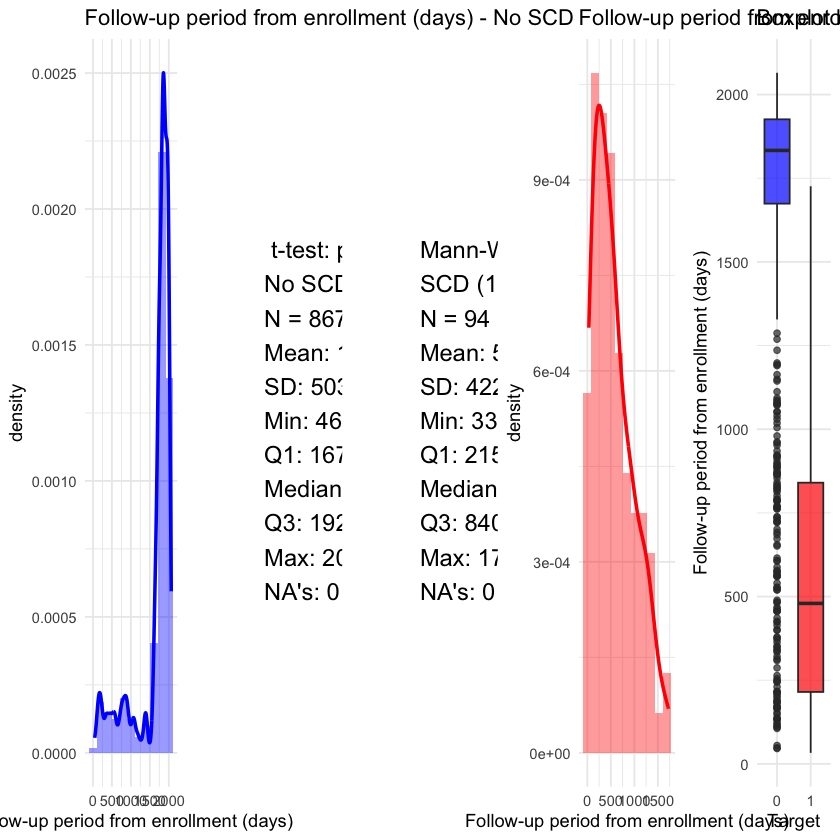

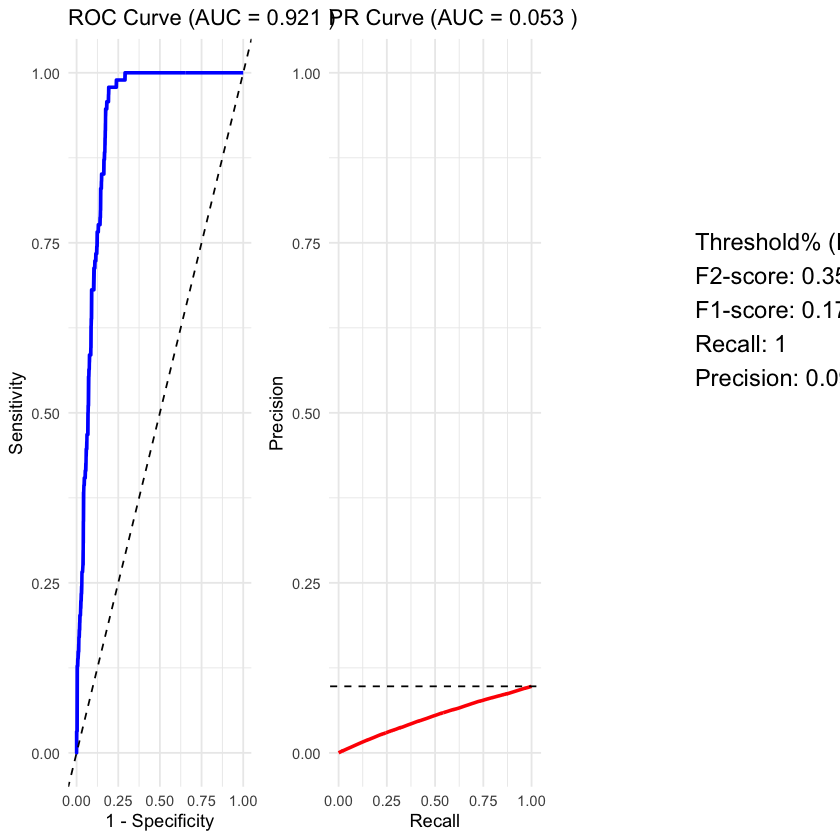

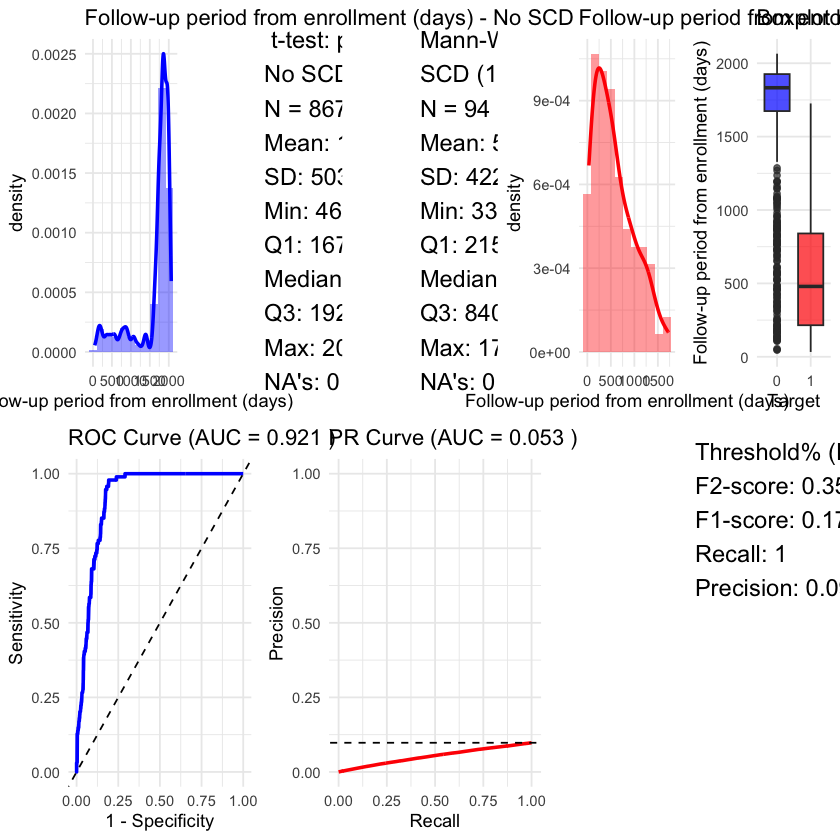

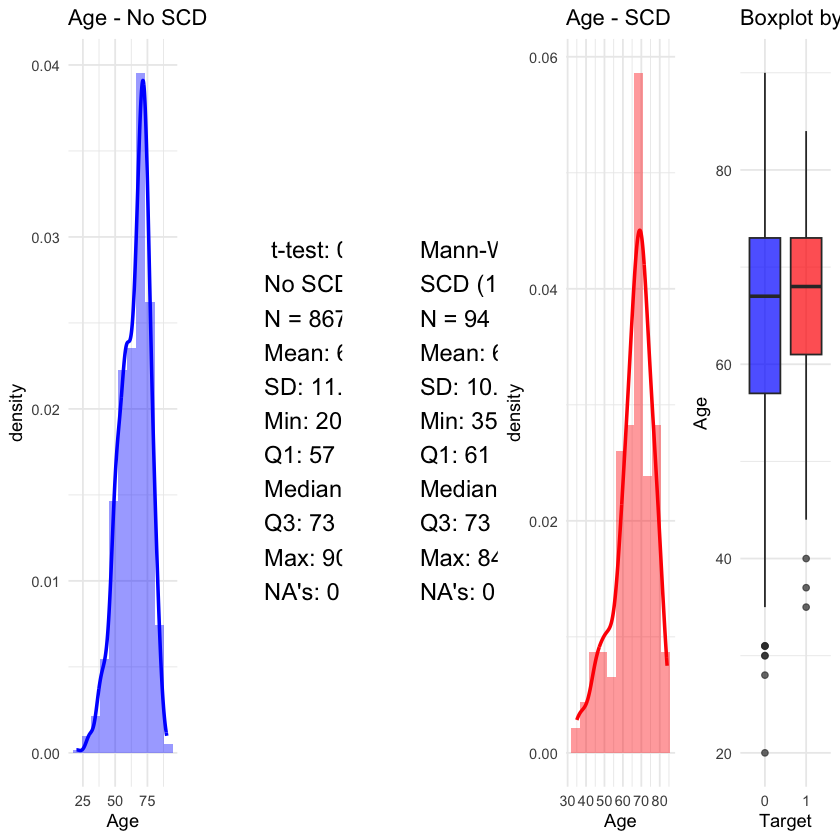

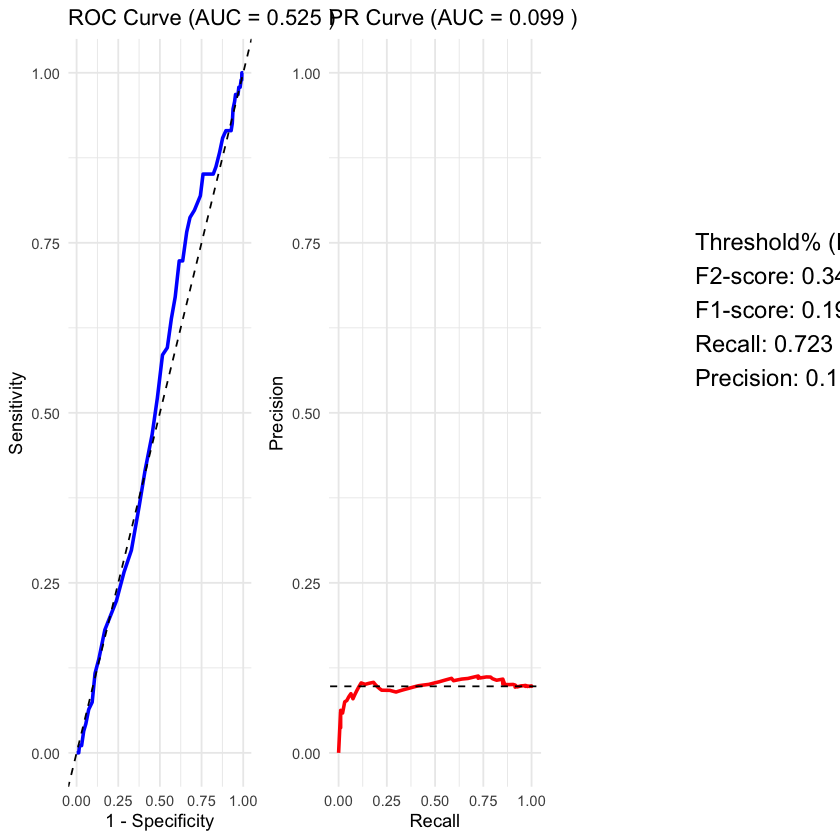

...

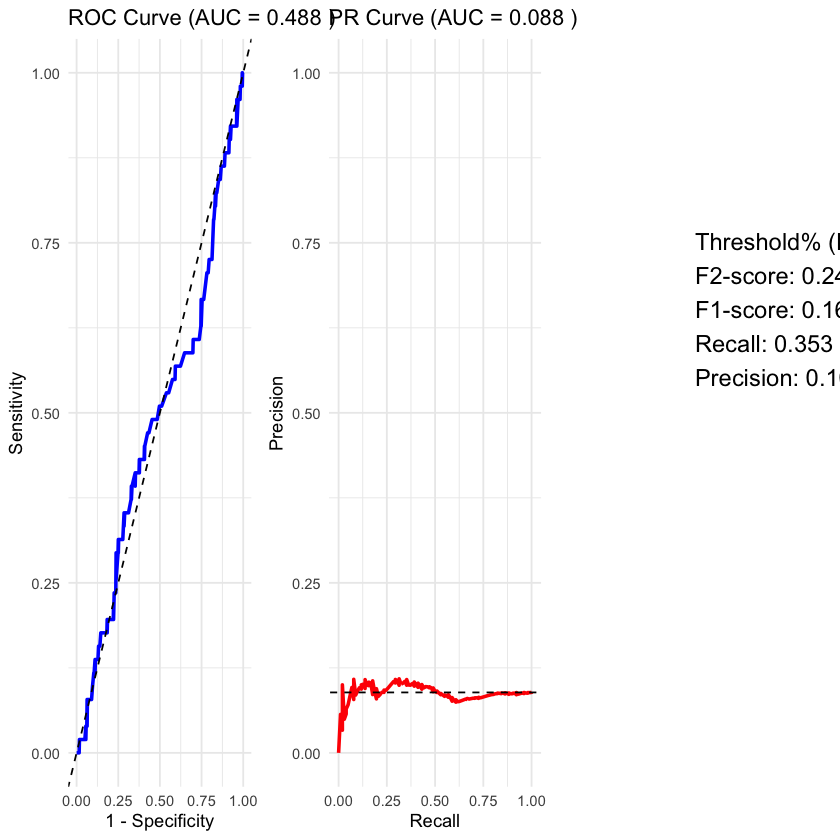

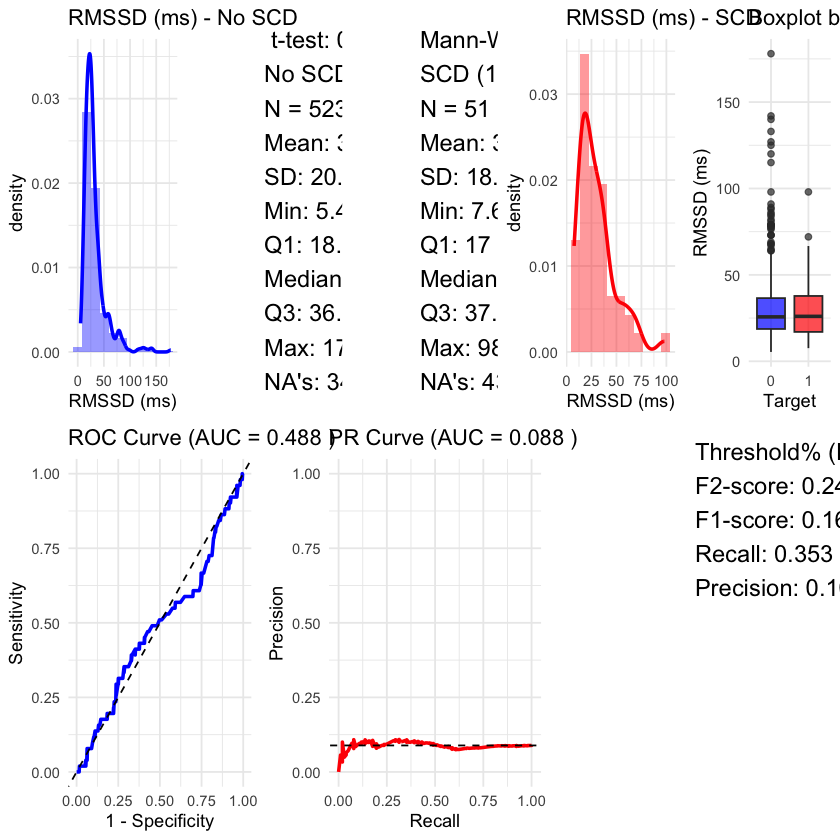

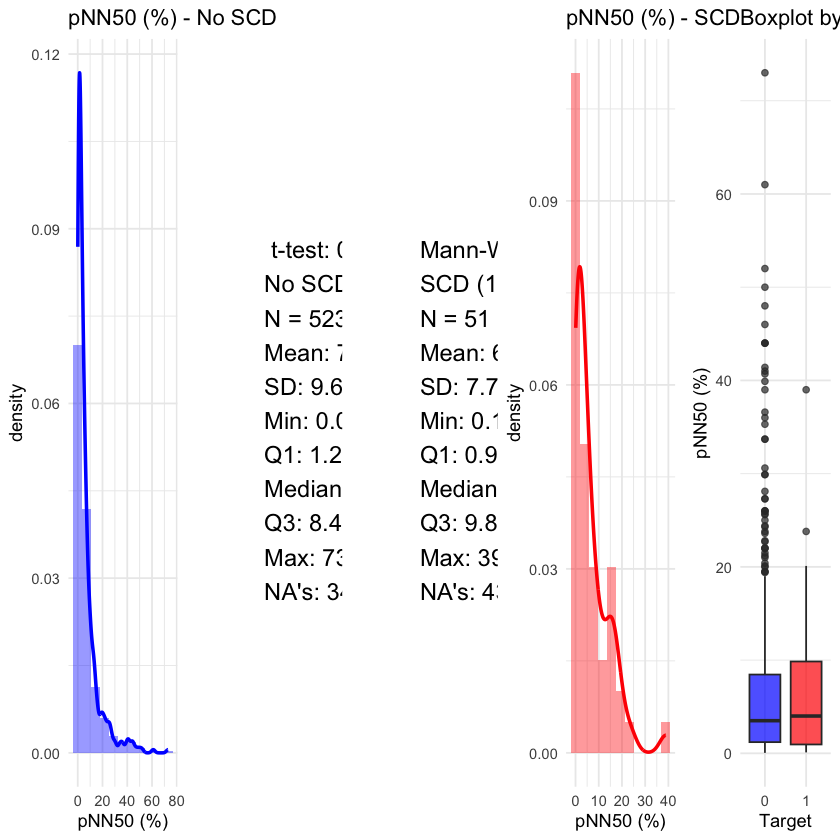

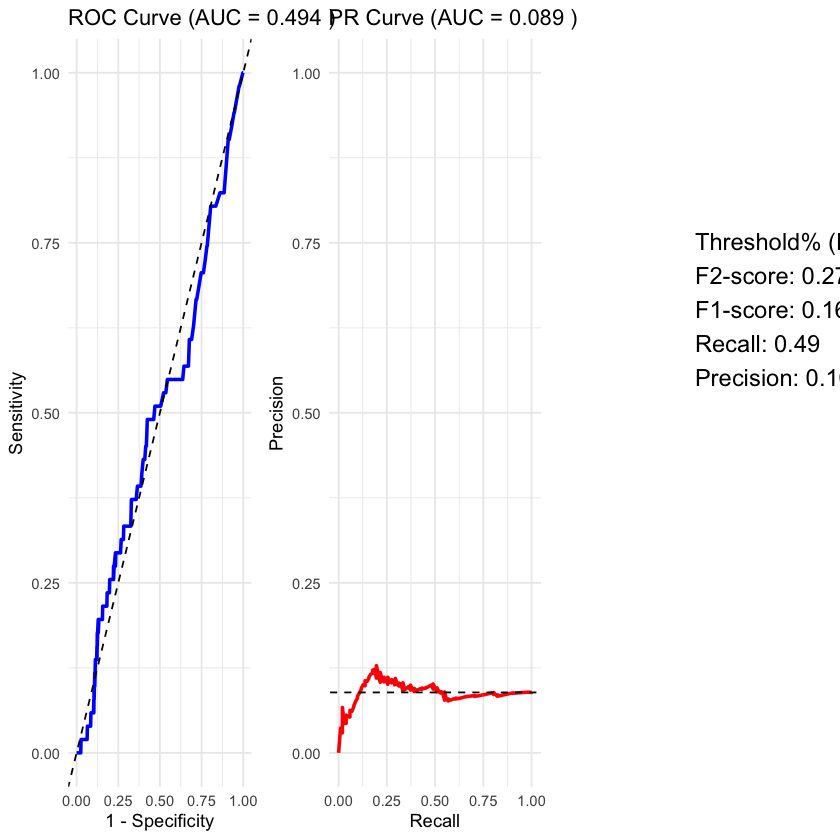

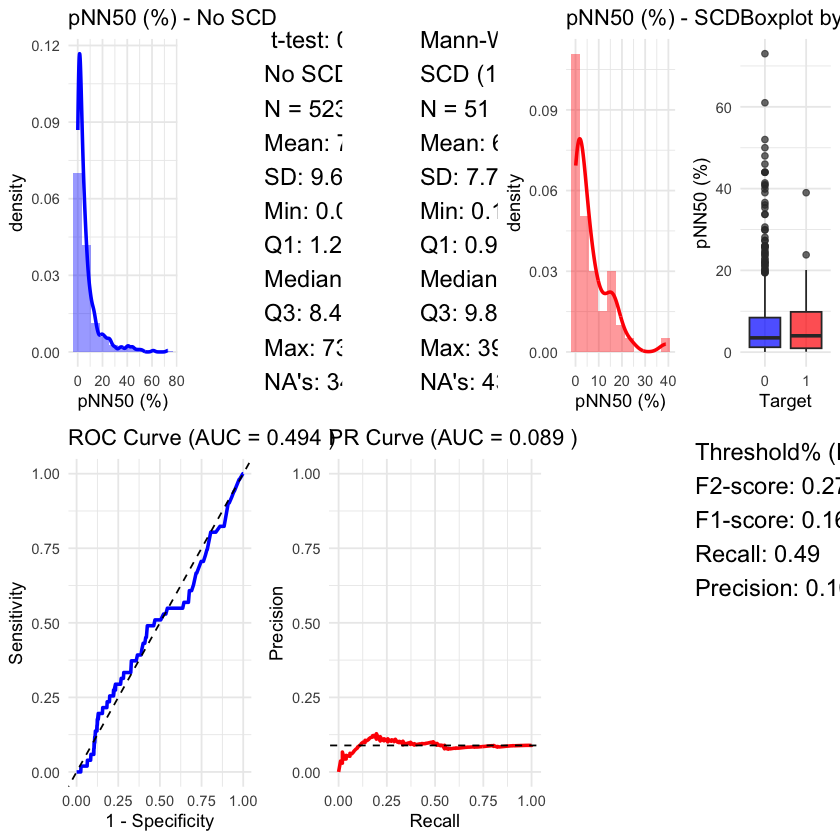

In [43]:
library(ggplot2)
library(gridExtra)
library(purrr)
library(patchwork)
library(pROC)
library(PRROC)
library(grid)
library(dplyr)
options(pROC_quiet = TRUE)


calculate_metrics <- function(pr_curve) {
  # Extrai a curva (recall, precision, threshold)
  curve_data <- pr_curve$curve
  
  # Nomeia as colunas para clareza
  colnames(curve_data) <- c("recall", "precision", "threshold")

  # Calcula F1 e F2 score
  curve_data <- as.data.frame(curve_data)
  curve_data$f1 <- with(curve_data, ifelse(precision + recall == 0, 0, 2 * precision * recall / (precision + recall)))
  curve_data$f2 <- with(curve_data, ifelse(precision + recall == 0, 0, 5 * precision * recall / (4 * precision + recall)))

  # Encontra o threshold que maximiza F1
  best_idx <- which.max(curve_data$f1)
  best <- curve_data[best_idx, ]

# Converte o threshold para percentual (0-100%)
  # Primeiro normaliza entre 0 e 1, depois multiplica por 100
  min_thresh <- min(curve_data$threshold)
  max_thresh <- max(curve_data$threshold)
  thresh_percent <- (best$threshold - min_thresh) / (max_thresh - min_thresh) * 100

  return(c(
    thresh = thresh_percent,
    f2 = best$f2,
    f1 = best$f1,
    recall = best$recall,
    precision = best$precision
  ))
}

# dataframe to sotre AUC results
auc_results <- data.frame(
  Variable = character(),
  AUC_ROC = numeric(),
  AUC_PR = numeric(),
  stringsAsFactors = FALSE
)

# List to store plots
all_plots <- list()

for (var_name in continuous_variables) {
  
  data <- subject_info %>% select(all_of(var_name), target) %>% na.omit()
  pr_curve <- pr.curve(
  scores.class0 = data[[var_name]],
  weights.class0 = data$target,
  curve = TRUE
)

  metrics <- calculate_metrics(pr_curve)
  
  
  na_count_by_target <- function(data, var_name) {
     na_0 <- sum(is.na(data[[var_name]][data$target == 0]))
     na_1 <- sum(is.na(data[[var_name]][data$target == 1]))
     return (c(na_target_0 = na_0, na_target_1 = na_1))
  }
  na_count <- na_count_by_target(subject_info,var_name)
  # Calculate metrics
  
  group0 <- data %>% filter(target == 0) %>% pull(var_name)
  group1 <- data %>% filter(target == 1) %>% pull(var_name)
  
  mean0 <- round(mean(group0), 2)
  sd0 <- round(sd(group0), 2)
  mean1 <- round(mean(group1), 2)
  sd1 <- round(sd(group1), 2)
  
  summary0 <- quantile(group0, probs = c(0, 0.25, 0.5, 0.75, 1), na.rm = TRUE)
  summary1 <- quantile(group1, probs = c(0, 0.25, 0.5, 0.75, 1), na.rm = TRUE)
  
  # Tests
  t_test <- tryCatch(t.test(group0, group1), error = function(e) NULL)
  mw_test <- tryCatch(wilcox.test(group0, group1, paired = FALSE), error = function(e) NULL)
  
  t_p <- if (!is.null(t_test)) format_p_value(t_test$p.value) else "NA"
  mw_p <- if (!is.null(mw_test)) format_p_value(mw_test$p.value) else "NA"
  
  # Create stats text for each group
  stats_text0 <- paste0(
    " t-test: ", t_p,"\n",
    "No SCD (0):\n",
    "N = ", length(group0), "\n",
    "Mean: ", mean0, "\n",
    "SD: ", sd0, "\n",
    "Min: ", round(summary0[1], 2), "\n",
    "Q1: ", round(summary0[2], 2), "\n",
    "Median: ", round(summary0[3], 2), "\n",
    "Q3: ", round(summary0[4], 2), "\n",
    "Max: ", round(summary0[5], 2), "\n",
    "NA's: ", na_count[["na_target_0"]]
  )
  
  stats_text1 <- paste0(
    "Mann-W: ", mw_p,"\n",
    "SCD (1):\n",
    "N = ", length(group1), "\n",
    "Mean: ", mean1, "\n",
    "SD: ", sd1, "\n",
    "Min: ", round(summary1[1], 2), "\n",
    "Q1: ", round(summary1[2], 2), "\n",
    "Median: ", round(summary1[3], 2), "\n",
    "Q3: ", round(summary1[4], 2), "\n",
    "Max: ", round(summary1[5], 2), "\n",
    "NA's: ", na_count[["na_target_1"]]
  )
  num_bins <- ceiling(log2(nrow(data)) + 1)

  # Histogram Left: only target == 0
  p_left <- ggplot(data %>% filter(target == 0), aes(x = .data[[var_name]])) +
    geom_histogram(aes(y = after_stat(density)), bins = num_bins, fill = "blue", alpha = 0.4) +
    geom_density(color = "blue", linewidth = 1) +
    labs(title = paste(var_name, "- No SCD")) +
    theme_minimal()
  
  # Histogram Right: only target == 1
  p_right <- ggplot(data %>% filter(target == 1), aes(x = .data[[var_name]])) +
    geom_histogram(aes(y = after_stat(density)), bins = num_bins, fill = "red", alpha = 0.4) +
    geom_density(color = "red", linewidth = 1) +
    labs(title = paste(var_name, "- SCD")) +
    theme_minimal()
  
  # Stats plots
  p_stats0 <- ggplot() +
    annotate("text", x = 0, y = 0.5, label = stats_text0, 
             hjust = 0, vjust = 0.5, size = 5) +
    theme_void()
  
  p_stats1 <- ggplot() +
    annotate("text", x = 0, y = 0.5, label = stats_text1, 
             hjust = 0, vjust = 0.5, size = 5) +
    theme_void()
  
  # Boxplot
  p_boxplot <- ggplot(data, aes(x = as.factor(target), y = .data[[var_name]], fill = as.factor(target))) +
    geom_boxplot(alpha = 0.7) +
    scale_fill_manual(values = c("0" = "blue", "1" = "red")) +
    labs(x = "Target", y = var_name, title = "Boxplot by Group") +
    theme_minimal() +
    theme(legend.position = "none")
  
  # ROC and PR curves
  roc_obj <- roc(data$target, data[[var_name]], quiet = TRUE)
  auc_roc <- as.numeric(auc(roc_obj))
  
  # PR Curve
  pr_curve <- pr.curve(scores.class0 = data[[var_name]], weights.class0 = data$target, curve = TRUE)
  auc_pr <- pr_curve$auc.integral
  
  # Armazenar resultados AUC
  auc_results <- rbind(auc_results, data.frame(
    Variable = var_name,
    AUC_ROC = auc_roc,
    AUC_PR = auc_pr
  ))
  
  # ROC plot
  roc_df <- data.frame(
    fpr = 1 - roc_obj$specificities,
    tpr = roc_obj$sensitivities
  )
  
  p_roc <- ggplot(roc_df, aes(x = fpr, y = tpr)) +
    geom_line(color = "blue", linewidth = 1) +
    geom_abline(slope = 1, intercept = 0, linetype = "dashed") +
    labs(title = paste("ROC Curve (AUC =", round(auc_roc, 3), ")"),
         x = "1 - Specificity", y = "Sensitivity") +
    theme_minimal()
  
  # PR plot
  pr_df <- data.frame(
    recall = pr_curve$curve[,1],
    precision = pr_curve$curve[,2]
  )
  
  p_pr <- ggplot(pr_df, aes(x = recall, y = precision)) +
    geom_line(color = "red", linewidth = 1) +
    geom_abline(slope = 0, intercept = mean(data$target), linetype = "dashed")+
    labs(title = paste("PR Curve (AUC =", round(auc_pr, 3), ")"),
         x = "Recall", y = "Precision") +
    theme_minimal() +
    xlim(0, 1) +
    ylim(0, 1)
  
  # Metrics plot
  metrics_text <- paste0(
    "Threshold% (F1-Max): ", round(metrics["thresh"], 2), "\n",
    "F2-score: ", round(metrics["f2"], 3), "\n",
    "F1-score: ", round(metrics["f1"], 3), "\n",
    "Recall: ", round(metrics["recall"], 3), "\n",
    "Precision: ", round(metrics["precision"], 3), "\n"
  )
  
  invisible(p_metrics <- ggplot() +
    annotate("text", x = 0, y = 0.5, label = metrics_text, 
             hjust = 0, vjust = 0, size = 5) +
    theme_void())
  
  # Combine plots
  invisible(top_row <- grid.arrange(p_left, p_stats0, p_stats1, p_right, p_boxplot, 
                         ncol = 5, widths = c(1.8, 1.5, 1.5, 1.8, 1.5)))
  
  invisible(bottom_row <- grid.arrange(p_roc, p_pr, p_metrics, 
                            ncol = 3, widths = c(1.8, 2, 2)))
  
  invisible(combined_plot <- grid.arrange(top_row, bottom_row, nrow = 2))
  
  invisible(all_plots[[var_name]] <- combined_plot)
  NULL
}


#### Saving in PDF and showing

In [45]:
# Sort by AUC-PR 
auc_results <- auc_results %>% arrange(desc(AUC_PR))
ordered_vars <- auc_results$Variable

# Pd
pdf("/Users/brunorocha/Aulas/HEADS/Sem2/LAB/contMusic2.pdf", width = 18, height = 10) 

for (var_name in ordered_vars) {
  data <- subject_info %>% select(all_of(var_name), target) %>% na.omit()
  invisible(grid.newpage())
  
  
  # Aumentar tamanho da fonte em todos os elementos
  current_plot <- all_plots[[var_name]]
  
  # Ajustar os títulos e textos
  current_plot$grobs[[1]] <- editGrob(current_plot$grobs[[1]], 
                                     gp = gpar(fontsize = 16))
  current_plot$grobs[[2]] <- editGrob(current_plot$grobs[[2]], 
                                     gp = gpar(fontsize = 16))
  invisible(grid.draw(current_plot))
  
  
  # titles ans mains metrics
  invisible(grid.text(paste0("", var_name,"\n", 
                  "AUC-PR: ", round(auc_results$AUC_PR[auc_results$Variable == var_name], 3),
                  " | Prev(1): ", round(mean(data$target), 3),"\n",                  
                  "AUC-ROC: ", round(auc_results$AUC_ROC[auc_results$Variable == var_name], 3)),
            x = 0.45, y = 0.98, just = "top", 
            gp = gpar(fontsize = 14, fontface = "bold")))
  NULL
}
invisible(dev.off())


# open pdf
system(paste0("open ", '"', "/Users/brunorocha/Aulas/HEADS/Sem2/LAB/contMusic2.pdf", '"'))

#### Backup univariate

In [46]:
# library(ggplot2)
# library(gridExtra)
# library(purrr)
# library(patchwork)
# library(pROC)
# library(grid)
# options(pROC_quiet = TRUE)
# #Important information: many features are measures from ECGs, holters and high resolutions ECG
# continuous_variables <- setdiff(names(subject_info), categ_variables)


# ##NAs in PR interval (ms) written as 999
# #summary(subject_info$`PR interval (ms)`)
# #Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
# #86.0   164.0   190.0   407.3   999.0   999.0   total(999): 256
# subject_info$`PR interval (ms)`[subject_info$`PR interval (ms)` == 999] <- NA

# #OBS:# Filter continuous variables
# # Follow-up period from enrollment (days) - not predictive - bias ?
# # Equivalent variables:
# #1. ´Number of ventricular premature contractions per hour` ~ `Number of ventricular premature beats in 24h`
# #2. "Average RR (ms)...74" ~ "Average RR (ms)...67"
# continuous_variables <- continuous_variables[!continuous_variables %in% c("Patient ID","Exit of the study","target","days_4years","Holter onset (hh:mm:ss)","Hig-resolution ECG available","holter avaiable","Number of ventricular premature contractions per hour","Cause of death","Average RR (ms)...74")]



# ### preparing to plot histograms , statistic tests ans paramets and roc curve
# # 3 variables per page

# # Store for AUCs
# auc_results <- data.frame(Variable = character(), AUC = numeric(), stringsAsFactors = FALSE)
# # Create a list to store all plots
# all_plots <- list()

# # Aux. Function to format p-values
# format_p_value <- function(p) {
#   if (is.na(p)) return("NA")
#   if (p < 0.001) return("p < .001")
#   return(formatC(p, format = "f", digits = 3))
# }



# for (var_name in continuous_variables) {
#   data <- subject_info %>% select(all_of(var_name), target) %>% na.omit()

#   group0 <- data %>% filter(target == 0) %>% pull(var_name)
#   group1 <- data %>% filter(target == 1) %>% pull(var_name)

#   mean0 <- round(mean(group0), 2)
#   sd0 <- round(sd(group0), 2)
#   mean1 <- round(mean(group1), 2)
#   sd1 <- round(sd(group1), 2)

#   summary0 <- quantile(group0, probs = c(0, 0.25, 0.5, 0.75, 1))
#   summary1 <- quantile(group1, probs = c(0, 0.25, 0.5, 0.75, 1))

#   # Tests
#   t_test <- tryCatch(t.test(group0, group1), error = function(e) NULL)
#   mw_test <- tryCatch(wilcox.test(group0, group1, paired = FALSE), error = function(e) NULL)

#   t_p <- if (!is.null(t_test)) format_p_value(t_test$p.value) else "NA"
#   mw_p <- if (!is.null(mw_test)) format_p_value(mw_test$p.value) else "NA"

#   # Create stats text
#   stats_text <- paste0(
#     "t-test: ", t_p, "\n",
#     "Mann-Whitney: ", mw_p, "\n\n",
#     "No SCD (0):\n",
#     "Mean/SD: ", mean0, " / ", sd0, "\n",
#     "Min-Max: ", round(summary0[1], 2), "-", round(summary0[5], 2), "\n",
#     "Q1-Q3: ", round(summary0[2], 2), "-", round(summary0[4], 2), "\n",
#     "Median: ", round(summary0[3], 2), "\n\n",
#     "SCD (1):\n",
#     "Mean/SD: ", mean1, " / ", sd1, "\n",
#     "Min-Max: ", round(summary1[1], 2), "-", round(summary1[5], 2), "\n",
#     "Q1-Q3: ", round(summary1[2], 2), "-", round(summary1[4], 2), "\n",
#     "Median: ", round(summary1[3], 2)
#   )
  
#   # Histogram Left: only target == 0
#   n0 <- length(group0)
#   bins0 <- ceiling(log2(n0) + 1)
#   p_left <- ggplot(data %>% filter(target == 0), aes(x = .data[[var_name]])) +
#     geom_histogram(aes(y = after_stat(density)), bins = bins0, fill = "blue", alpha = 0.4) +
#     geom_density(color = "blue", linewidth = 1) +
#     labs(title = var_name, subtitle = "No SCD") +
#     theme_minimal() +
#     theme(plot.margin = margin(r = 20))
  
#   # Histogram Right: only target == 1
#   n1 <- length(group1)
#   bins1 <- ceiling(log2(n1) + 1)
#   p_right <- ggplot(data %>% filter(target == 1), aes(x = .data[[var_name]])) +
#     geom_histogram(aes(y = after_stat(density)), bins = bins1, fill = "red", alpha = 0.4) +
#     geom_density(color = "red", linewidth = 1) +
#     labs(title = var_name, subtitle = "SCD") +
#     theme_minimal() +
#     theme(plot.margin = margin(l = 20))
    
#   # Stats plot (middle)
#   p_stats <- ggplot() +
#     annotate("text", x = 0, y = 0.5, label = stats_text, 
#              hjust = 0.5, vjust = 0.5, size = 3.5) +
#     theme_void() +
#     theme(plot.margin = margin(l = 10, r = 10))
  
#   # Boxplot
#   p_boxplot <- ggplot(data, aes(x = as.factor(target), y = .data[[var_name]], fill = as.factor(target))) +
#     geom_boxplot(alpha = 0.7) +
#     scale_fill_manual(values = c("0" = "blue", "1" = "red")) +
#     labs(x = "Target", y = var_name, title = "Boxplot by Group") +
#     theme_minimal() +
#     theme(legend.position = "none",
#           plot.title = element_text(size = 10),
#           axis.title = element_text(size = 8),
#           plot.margin = margin(t = 10, b = 10))
  
#   # ROC
#   roc_obj <- roc(data$target, data[[var_name]], quiet = TRUE)
#   auc_value <- as.numeric(auc(roc_obj))
#   auc_results <- rbind(auc_results, data.frame(Variable = var_name, AUC = auc_value))
  
#   roc_df <- data.frame(
#     fpr = 1 - roc_obj$specificities,
#     tpr = roc_obj$sensitivities
#   )
  
#   p_roc <- ggplot(roc_df, aes(x = fpr, y = tpr)) +
#     geom_area(fill = "gray80", alpha = 0.6) +
#     geom_line(color = "black", linewidth = 1) +
#     geom_abline(slope = 1, intercept = 0, linetype = "dashed", color = "gray") +
#     labs(title = paste("ROC Curve (AUC =", round(auc_value, 3), ")"),
#          x = "1 - Specificity", y = "Sensitivity") +
#     theme_minimal() +
#     theme(plot.title = element_text(size = 10),
#           axis.title = element_text(size = 8),
#           plot.margin = margin(t = 10, b = 10))
  
#   # Combine plots
#   combined_plot <- grid.arrange(
#     p_left, p_stats, p_right, p_boxplot, p_roc,
#     ncol = 5,
#     widths = c(2, 0.85, 2, 1.5, 1.5))
  
#   all_plots[[var_name]] <- combined_plot
# }

# #print(all_plots)
# auc_results <- auc_results %>% arrange(desc(AUC))
# print(auc_results) #56
# pdf("/Users/brunorocha/Aulas/HEADS/Sem2/LAB/contMusic2.pdf", width = 18, height = 10) 

# # Obter os nomes das variáveis
# plot_names <- auc_results$Variable

# # Criar páginas com 3 variáveis por página
# for (i in seq(1, length(all_plots), by = 3)) {
#   plots_batch <- all_plots[plot_names[i:min(i+2, length(all_plots))]]
  
#   # Organiza os 3 plots (ou menos na última página) verticalmente
#   grid.arrange(grobs = plots_batch, ncol = 1)
# }

# dev.off()
# system(paste0("open ", '"', "/Users/brunorocha/Aulas/HEADS/Sem2/LAB/contMusic2.pdf", '"'))





### Filtering continuous variavles 
#### - Statistical critria AUCPR > 0.125
#### - Clinical and equivalece criteria - " QRS duration (ms)", "SDNN (ms)", "QT corrected","Age","LVEF (%)"

In [47]:
continuous_chosen <- auc_results$Variable[c(1:9)] 
continuous_chosen <- c(continuous_chosen,"QRS duration (ms)", "SDNN (ms)", "QT corrected","Age","LVEF (%)")
print(continuous_chosen)#14

 [1] "Pro-BNP (ng/L)"                              
 [2] "Left atrial size (mm)"                       
 [3] "PR interval (ms)"                            
 [4] "Extrasystole couplets"                       
 [5] "Left ventricle end-diastolic diameter (mm)"  
 [6] "Number of ventricular premature beats in 24h"
 [7] "Left ventricle end-systolic diameter (mm)"   
 [8] "Creatinine (?mol/L)"                         
 [9] "Normalized Troponin"                         
[10] "QRS duration (ms)"                           
[11] "SDNN (ms)"                                   
[12] "QT corrected"                                
[13] "Age"                                         
[14] "LVEF (%)"                                    


## 5. Multivariate Analysis (Coninuous, Ordinals and Categorical)

### Correlations Pearson, Spearman and Cramér’s V

corrplot 0.95 loaded



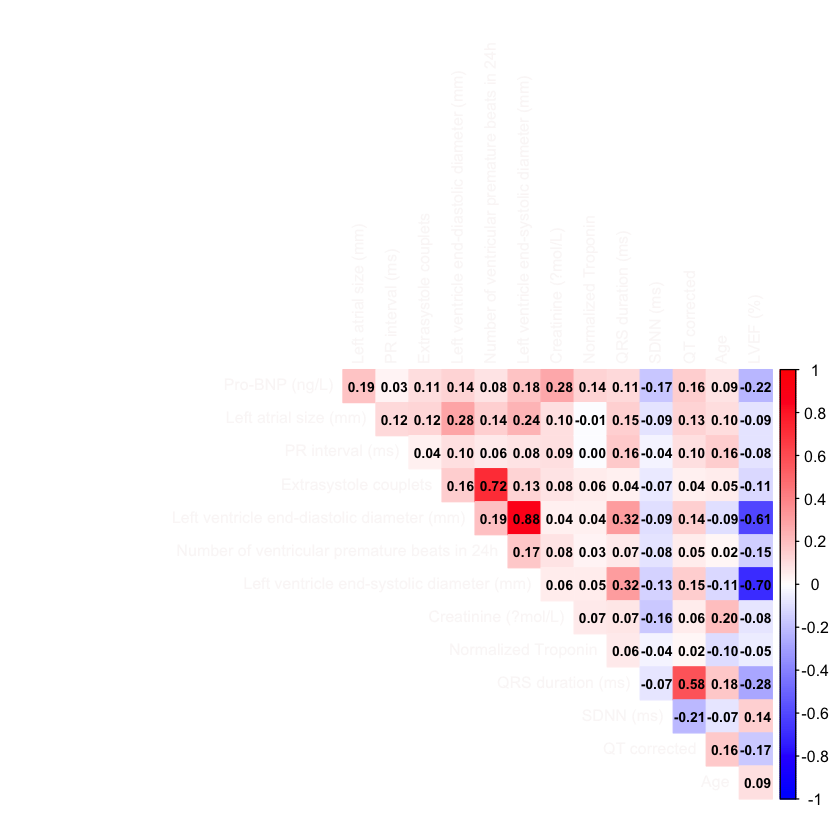

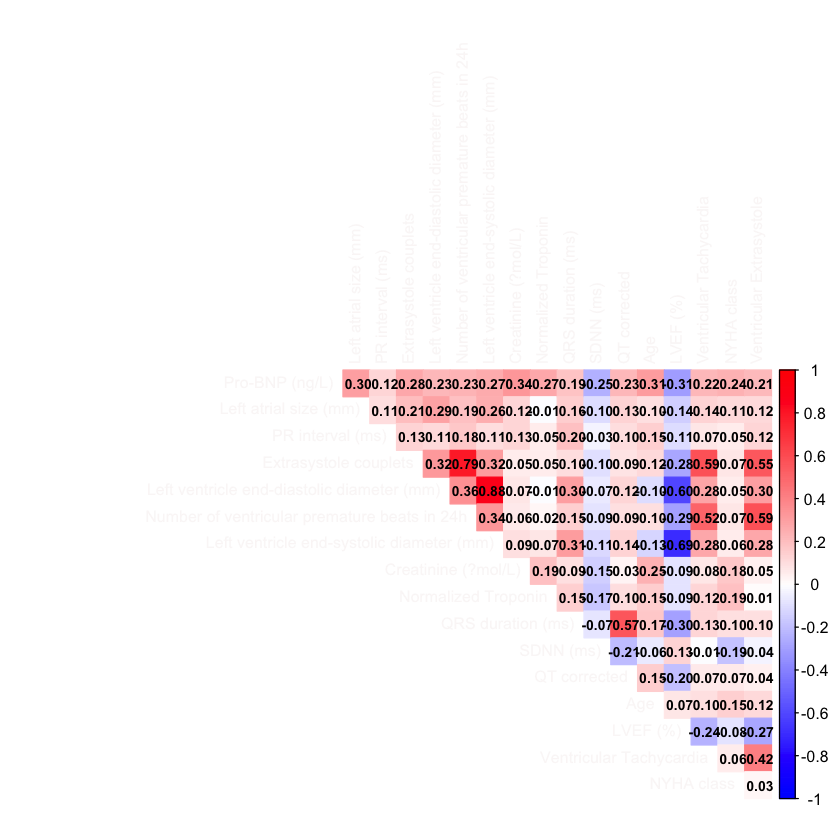

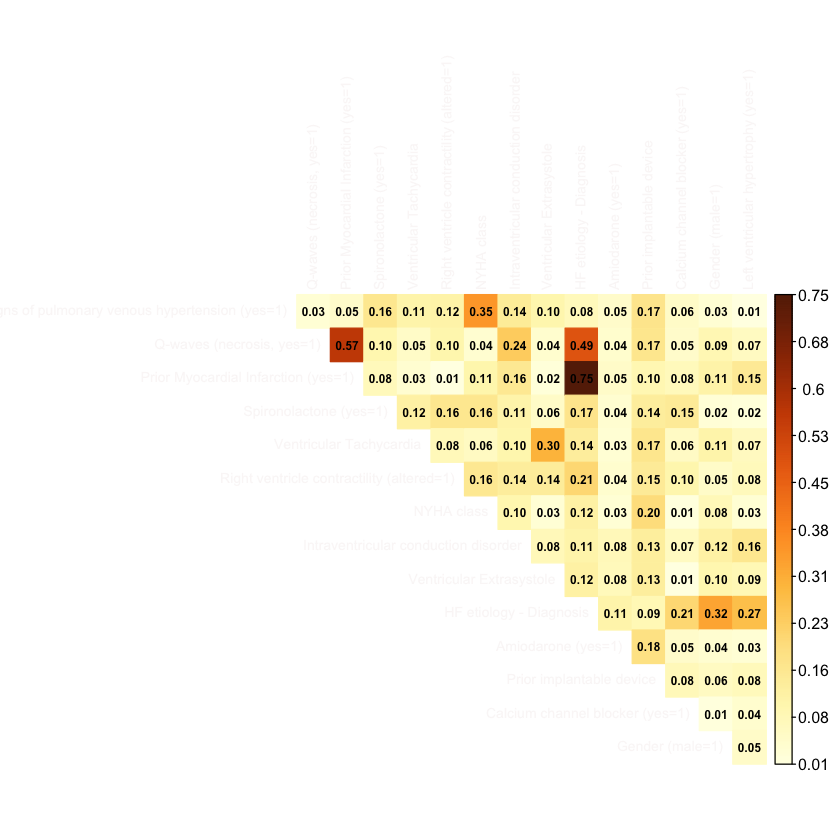

In [48]:

#Pearson correlations

df_only_cont <- subject_info[, continuous_chosen]
# cleaning only necessary NAs for each time
cor_pairwise <- function(x,y) {
  m <- matrix(NA, ncol = length(x), nrow = length(x))
  colnames(m) <- rownames(m) <- names(x)
  for (i in 1:length(x)) {
    for (j in i:length(x)) {
      pair_data <- na.omit(data.frame(x[[i]], x[[j]]))
      if (nrow(pair_data) > 1) {
        r <- cor(pair_data[[1]], pair_data[[2]], method = y)
        m[i, j] <- m[j, i] <- r
      }
    }
  }
  return(m)
}


cor_matrix <- cor_pairwise(df_only_cont,"pearson")

# Plotar heatmap com cores invertidas (negativo = vermelho, positivo = azul)
library(corrplot)
corrplot(cor_matrix,
         method = "color",
         type = "upper",
         tl.col = "#faf7f7",
         tl.cex = 0.8,
         addCoef.col = "black",
         number.cex = 0.7,
         diag = FALSE,
         col = colorRampPalette(c(  "blue","white","red"))(200))


#Spearman correlations - ordinal and continuous
categ_ord <- c("Ventricular Tachycardia", "NYHA class", "Ventricular Extrasystole")
vars_to_use <- c(continuous_chosen, categ_ord)
df_ord <- subject_info %>% select(all_of(vars_to_use))
#summary(df_ord)
cor_matrix2 <- cor_pairwise(df_ord,"spearman")


corrplot(cor_matrix2,
         method = "color",
         type = "upper",
         tl.col = "#faf7f7",
         tl.cex = 0.8,
         addCoef.col = "black",
         number.cex = 0.7,
         diag = FALSE,
         col = colorRampPalette(c(  "blue","white","red"))(200))



library(tidyr)

# Function to extract unique strong/moderate correlations
extract_unique_correlations <- function(cor_matrix, method_name) {
  cor_matrix %>%
    as.data.frame() %>%
    tibble::rownames_to_column("Variable1") %>%
    pivot_longer(
      cols = -Variable1,
      names_to = "Variable2",
      values_to = "Correlation"
    ) %>%
    filter(Variable1 != Variable2) %>%  # Remove self-correlations
    # Ensure only unique pairs (e.g., keep "x1-x2" but remove "x2-x1")
    rowwise() %>%
    mutate(
      Pair_ID = paste(sort(c(Variable1, Variable2)), collapse = "-")
    ) %>%
    ungroup() %>%
    distinct(Pair_ID, .keep_all = TRUE) %>%  # Keep only one permutation
    select(-Pair_ID) %>%
    mutate(
      Strength = case_when(
        abs(Correlation) >= 0.7 ~ "Strong",
        abs(Correlation) >= 0.4 ~ "Moderate",
        TRUE ~ "Weak/None"
      ),
      Method = method_name
    ) %>%
    filter(Strength %in% c("Strong", "Moderate")) %>%
    arrange(desc(abs(Correlation)))
}

# Apply to Pearson and Spearman matrices
pearson_results <- extract_unique_correlations(cor_matrix, "Pearson")
spearman_results <- extract_unique_correlations(cor_matrix2, "Spearman")


corr_results <- bind_rows(pearson_results, spearman_results)


#print(corr_results)


# updating chosens
categorical_chosen <- setdiff(categorical_chosen, c(
  "Non-sustained ventricular tachycardia (CH>10)", # ~ Ventricular Tachycardia 
  "QRS > 120 ms" # ~QRS duration (ms) 
))

# "Extrasystole couplets", # ~Ventricular Extrasystole" and "Number of ventricular premature beats in 24h"
continuous_chosen <- setdiff(continuous_chosen, c(
  "Left ventricle end-systolic diameter (mm)" #only "Left ventricle end-diastolic diameter (mm)" and LVEF stay
))
#print(categorical_chosen) #14
#print(continuous_chosen) #11


# Categorical Correlations - Cramér’s V

library(vcd)

#  Cramér’s V - categorical 
cramers_v <- function(x, y) {
  tbl <- table(x, y)
  assocstats(tbl)$cramer
}

# Subset do dataframe com as variáveis categóricas escolhidas
df_cat <- subject_info[, categorical_chosen]

# Converter tudo para fator (assumindo que você vai revisar se são nominais ou ordinais depois)
df_cat[] <- lapply(df_cat, as.factor)

# empty matrix
n <- length(categorical_chosen)
cramer_matrix <- matrix(NA, nrow = n, ncol = n,
                        dimnames = list(categorical_chosen, categorical_chosen))


for (i in 1:n) {
  for (j in 1:n) {
    cramer_matrix[i, j] <- cramers_v(df_cat[[i]], df_cat[[j]])
  }
}

#heatmap
corrplot(cramer_matrix, method = "color", type = "upper",
         tl.col = "#faf7f7", tl.cex = 0.7,
         is.corr = FALSE, 
         diag = FALSE,
         addCoef.col = "black", number.cex = 0.6)



# updating chosens
categorical_chosen <- setdiff(categorical_chosen, c(
  "Prior Myocardial Infarction (yes=1)" # stayed "HF etiology - Diagnosis" and "Q-waves (necrosis, yes=1)"
))
#print(categorical_chosen) #14
#print(continuous_chosen) #11

### 7. Analysing impact of removing NAs - filtering features by higher number of missing datas

variable,n_miss,pct_miss
<chr>,<int>,<num>
SDNN (ms),387,40.3
PR interval (ms),269,28.0
Normalized Troponin,155,16.1
Pro-BNP (ng/L),116,12.1
Ventricular Tachycardia,68,7.08
Extrasystole couplets,64,6.66
Ventricular Extrasystole,64,6.66
Number of ventricular premature beats in 24h,59,6.14
Right ventricle contractility (altered=1),14,1.46



Anexando pacote: 'data.table'


O seguinte objeto 'e mascarado por 'package:rlang':

    :=


O seguinte objeto 'e mascarado por 'package:purrr':

    transpose


Os seguintes objetos s~ao mascarados por 'package:dplyr':

    between, first, last




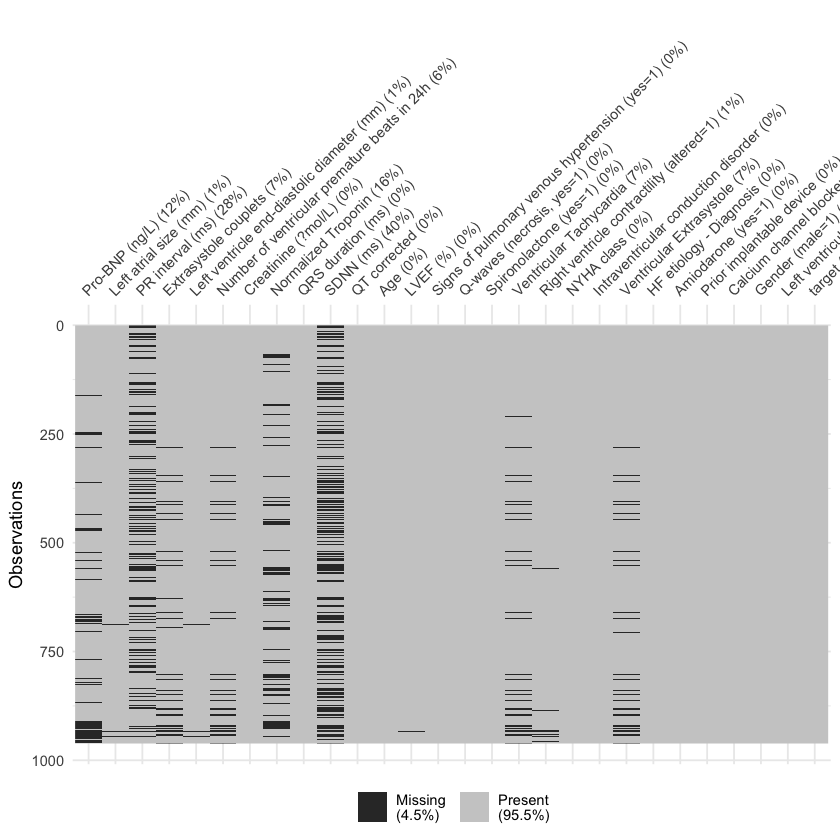

In [49]:
df_end_variables_notarget <- subject_info[, c(continuous_chosen,categorical_chosen)]
df_end_variables <- cbind(df_end_variables_notarget, target = subject_info$target)

library(naniar)
miss_var_summary(df_end_variables)  # NAs / column

vis_miss(df_end_variables)

library(data.table)


### Excluded featutes more 20% or more of NAs in target :1

In [50]:
# if remove NASn new numbers of dataset(0 1) :  "SDNN (ms)"523  51 , "PR interval (ms)"631  61 , "Normalized Troponin" 731  75 , "Pro-BNP (ng/L)764  81
#sum(!is.na(df_end_variables$"Extrasystole couplets") & df_end_variables$target == 1) 88
#str(df_end_variables)
df_end_variables <- df_end_variables[, !(names(df_end_variables) %in% c("SDNN (ms)","Normalized Troponin" ,"PR interval (ms)"))]
#str(df_end_variables$Extrasystole couplets
table(df_end_variables$target)
#str(df_end_variables)
table(df_end_variables$target)
df_sem_na <- na.omit(df_end_variables)
#str(df_sem_na)
table(df_sem_na$target)



  0   1 
867  94 


  0   1 
867  94 


  0   1 
710  75 


### 8. Analyse of clinically related covariates and iteractions: 

In [51]:

# Number of ventricular premature beats in 24h` * Ventricular Extrasystole` * `Ventricular Tachycardia` 

# individual models
modelo_beats <- glm(target ~ `Number of ventricular premature beats in 24h`, 
                    data = subject_info, family = binomial)

modelo_extrasystole <- glm(target ~ `Ventricular Extrasystole`, 
                           data = subject_info, family = binomial)

modelo_tachycardia <- glm(target ~ `Ventricular Tachycardia`, 
                          data = subject_info, family = binomial)
modelo_coup <- glm(target ~ `Extrasystole couplets`, 
                    data = subject_info, family = binomial)




#summary(modelo_beats)
#summary(modelo_extrasystole)
#summary(modelo_tachycardia) #melhorAIC: 561.07
#summary(modelo_coup)

In [52]:
# only joint 
modelo_conjunto <- glm(target ~ 
                         `Number of ventricular premature beats in 24h` + 
                         `Ventricular Extrasystole` + 
                         `Ventricular Tachycardia`,
                       data = subject_info,
                       family = binomial)

# Model with interaction
modelo_interacao <- glm(target ~ 
                          `Number of ventricular premature beats in 24h` + 
                          `Ventricular Extrasystole` + 
                          `Ventricular Tachycardia` +
                          `Number of ventricular premature beats in 24h`:`Ventricular Extrasystole` +
                          `Number of ventricular premature beats in 24h`:`Ventricular Tachycardia` +
                          `Ventricular Extrasystole`:`Ventricular Tachycardia` +
                          `Number of ventricular premature beats in 24h`:`Ventricular Extrasystole`:`Ventricular Tachycardia`, 
                        data = subject_info,
                        family = binomial)
#summary(modelo_conjunto) #AIC: 557.39 - no stats sig for coeficientes
#summary(modelo_interacao)

# Comparing models 
anova(modelo_conjunto, modelo_interacao, test = "Chisq")
#anova(modelo_conjunto, modelo_tachycardia, test = "Chisq")
#summary(modelo_extrasystole)
#summary(modelo_tachycardia) #melhorAIC: 561.07

#conclusion: stay only `Ventricular Tachycardia`
df_end_variables <- df_end_variables[, !(names(df_end_variables) %in% c("Number of ventricular premature beats in 24h", "Ventricular Extrasystole","Extrasystole couplets"))]
print(names(df_end_variables))

,Resid. Df,Resid. Dev,Df,Deviance,Pr(>Chi)
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,884,549.3921,NA,NA,NA
2,880,545.7556,4,3.636511,0.4574272


 [1] "Pro-BNP (ng/L)"                                
 [2] "Left atrial size (mm)"                         
 [3] "Left ventricle end-diastolic diameter (mm)"    
 [4] "Creatinine (?mol/L)"                           
 [5] "QRS duration (ms)"                             
 [6] "QT corrected"                                  
 [7] "Age"                                           
 [8] "LVEF (%)"                                      
 [9] "Signs of pulmonary venous hypertension (yes=1)"
[10] "Q-waves (necrosis, yes=1)"                     
[11] "Spironolactone (yes=1)"                        
[12] "Ventricular Tachycardia"                       
[13] "Right ventricle contractility (altered=1)"     
[14] "NYHA class"                                    
[15] "Intraventricular conduction disorder"          
[16] "HF etiology - Diagnosis"                       
[17] "Amiodarone (yes=1)"                            
[18] "Prior implantable device"                      
[19] "Calcium channel blocke

### 9. Imputing missing data using missForest by each target

In [53]:
#str(df_end_variables)

library(missForest)
df_target_0 <- subset(df_end_variables, target == 0)
df_target_1 <- subset(df_end_variables, target == 1)

# Drop the target column temporarily 
X_0 <- df_target_0[, !(names(df_target_0) %in% 'target')]
X_1 <- df_target_1[, !(names(df_target_1) %in% 'target')]
#str(X_0)
# Apply factor conversion to the categorical variables
X_0[, 9:21] <- lapply(X_0[, 9:21], as.factor)
X_1[, 9:21] <- lapply(X_1[, 9:21], as.factor)

# Apply MissForest separately to each subset
set.seed(42)
X_0_imputed <- missForest(X_0)$ximp

set.seed(42)
X_1_imputed <- missForest(X_1)$ximp

# 4. Add back the 'target' column
df_target_0_imputed <- cbind(X_0_imputed, target = 0)
df_target_1_imputed <- cbind(X_1_imputed, target = 1)

# 5. Concatenate the two parts to form the final imputed dataframe
df_end_imputed <- rbind(df_target_0_imputed, df_target_1_imputed)

# 6 Order the dataframe by rownames if you want to maintain the original order
df_end_imputed <- df_end_imputed[order(as.numeric(rownames(df_end_imputed))), ]
#str(df_end_imputed)
target<-df_end_imputed$"target"
df_end_imputed <- cbind(df_end_imputed[, 1:8], lapply(df_end_imputed[, 9:21], function(x) as.numeric(levels(x))[as.numeric(x)]), target)
#str(df_end_variables)

### Comparing before and after imput data - Similar results*

In [54]:

# - df_end_variables (original, untouched)
# - df_end_imputed (after MissForest imputation)

# Continuous variables
continuous_vars <- colnames(df_end_variables)[1:8]

# Initialize list to store differences
diff_continuous <- list()

# Function to compute metrics
compute_metrics <- function(x) {
  c(
    Mean = mean(x, na.rm = TRUE),
    SD = sd(x, na.rm = TRUE),
    Median = median(x, na.rm = TRUE),
    Q1 = quantile(x, 0.25, na.rm = TRUE),
    Q3 = quantile(x, 0.75, na.rm = TRUE),
    Min = min(x, na.rm = TRUE),
    Max = max(x, na.rm = TRUE)
  )
}

# Loop through each continuous variable
for (var in continuous_vars) {
  original_metrics <- compute_metrics(df_end_variables[[var]])
  imputed_metrics  <- compute_metrics(df_end_imputed[[var]])
  
  diffs <- data.frame(Metric = names(original_metrics),
                      Original = original_metrics,
                      Imputed = imputed_metrics) %>%
    filter(abs(Original - Imputed) > 1e-3)  # consider small tolerance for floating numbers
  
  if (nrow(diffs) == 0) {
    diff_continuous[[var]] <- "OK"
  } else {
    diffs$Variable <- var
    diff_continuous[[var]] <- diffs
  }
}

# Print differences
for (var in names(diff_continuous)) {
  cat("\n\n====", var, "====\n")
  print(diff_continuous[[var]])
}

# Categorical variables
categorical_vars <- colnames(df_end_variables)[8:20]

# Initialize list to store differences
diff_categorical <- list()

# Loop through each categorical variable
for (var in categorical_vars) {
  # Compute proportions
  prop_original <- df_end_variables %>%
    count(!!sym(var)) %>%
    mutate(Proportion = n / sum(n) * 100) %>%
    rename(Class = !!sym(var))
  
  prop_imputed <- df_end_imputed %>%
    count(!!sym(var)) %>%
    mutate(Proportion = n / sum(n) * 100) %>%
    rename(Class = !!sym(var))
  
  # Merge to compare
  prop_compare <- full_join(prop_original, prop_imputed, by = "Class", suffix = c("_Original", "_Imputed")) %>%
    mutate(across(c(Proportion_Original, Proportion_Imputed), ~replace_na(., 0))) %>%
    filter(abs(Proportion_Original - Proportion_Imputed) > 1e-2)
  
  if (nrow(prop_compare) == 0) {
    diff_categorical[[var]] <- "OK"
  } else {
    prop_compare$Variable <- var
    diff_categorical[[var]] <- prop_compare
  }
}

# Print differences
for (var in names(diff_categorical)) {
  cat("\n\n====", var, "====\n")
  print(diff_categorical[[var]])
}



==== Pro-BNP (ng/L) ====
       Metric Original  Imputed       Variable
Mean     Mean  1938.44 1965.076 Pro-BNP (ng/L)
SD         SD  3539.13 3360.155 Pro-BNP (ng/L)
Median Median   797.00  910.000 Pro-BNP (ng/L)
Q1.25% Q1.25%   333.00  403.000 Pro-BNP (ng/L)
Q3.75% Q3.75%  2035.00 2176.000 Pro-BNP (ng/L)


==== Left atrial size (mm) ====
     Metric  Original   Imputed              Variable
Mean   Mean 45.733193 45.753755 Left atrial size (mm)
SD       SD  7.964975  7.933536 Left atrial size (mm)


==== Left ventricle end-diastolic diameter (mm) ====
       Metric Original  Imputed                                   Variable
Mean     Mean 60.82827 60.85272 Left ventricle end-diastolic diameter (mm)
SD         SD 10.21498 10.19123 Left ventricle end-diastolic diameter (mm)
Q1.25% Q1.25% 54.00000 55.00000 Left ventricle end-diastolic diameter (mm)


==== Creatinine (?mol/L) ====
[1] "OK"


==== QRS duration (ms) ====
[1] "OK"


==== QT corrected ====
[1] "OK"


==== Age ====
[1] "OK"




## 10. Multicolinearity Analisys
#### VIF - Variance Inflation Factor

In [55]:

library(car)
modelo_inicial <- glm(target ~ ., data = df_end_variables, family = binomial)
modelo_inicial_imputed <- glm(target ~ ., data = df_end_imputed, family = binomial)

vif_valores <- vif(modelo_inicial)
vif_valoresIm <- vif(modelo_inicial_imputed)
#results sorted
vif_valores[order(vif_valores, decreasing = TRUE)]
vif_valoresIm[order(vif_valoresIm, decreasing = TRUE)]


Carregando pacotes exigidos: carData


Anexando pacote: 'car'


O seguinte objeto 'e mascarado por 'package:purrr':

    some


O seguinte objeto 'e mascarado por 'package:dplyr':

    recode




`LVEF (%)` 
                                        2.083066 
    `Left ventricle end-diastolic diameter (mm)` 
                                        2.018327 
                             `QRS duration (ms)` 
                                        1.895647 
                                  `QT corrected` 
                                        1.625058 
     `Right ventricle contractility (altered=1)` 
                                        1.420251 
                         `Left atrial size (mm)` 
                                        1.408231 
                                `Pro-BNP (ng/L)` 
                                        1.391643 
                                    `NYHA class` 
                                        1.278421 
                       `HF etiology - Diagnosis` 
                                        1.256365 
                           `Creatinine (?mol/L)` 
                                        1.253576 
                        `Spironolactone (yes=1)` 
                                        1.232243 
`Signs of pulmonary venous hypertension (yes=1)` 
                                        1.226507 
                     `Q-waves (necrosis, yes=1)` 
                                        1.223948 
                               `Gender (male=1)` 
                                        1.205875 
                       `Ventricular Tachycardia` 
                                        1.177046 
                      `Prior implantable device` 
                                        1.155554 
          `Intraventricular conduction disorder` 
                                        1.143869 
               `Calcium channel blocker (yes=1)` 
                                        1.136691 
                                             Age 
                                        1.124940 
          `Left ventricular hypertrophy (yes=1)` 
                                        1.099349 
                            `Amiodarone (yes=1)` 
                                        1.058814

`LVEF (%)` 
                                        1.983989 
    `Left ventricle end-diastolic diameter (mm)` 
                                        1.903981 
                             `QRS duration (ms)` 
                                        1.862279 
                                  `QT corrected` 
                                        1.584180 
                                `Pro-BNP (ng/L)` 
                                        1.384530 
     `Right ventricle contractility (altered=1)` 
                                        1.345006 
                         `Left atrial size (mm)` 
                                        1.331218 
                                    `NYHA class` 
                                        1.315638 
                       `HF etiology - Diagnosis` 
                                        1.294577 
                           `Creatinine (?mol/L)` 
                                        1.248516 
`Signs of pulmonary venous hypertension (yes=1)` 
                                        1.239355 
                        `Spironolactone (yes=1)` 
                                        1.218028 
                      `Prior implantable device` 
                                        1.195851 
                               `Gender (male=1)` 
                                        1.190528 
                       `Ventricular Tachycardia` 
                                        1.182908 
                     `Q-waves (necrosis, yes=1)` 
                                        1.166065 
               `Calcium channel blocker (yes=1)` 
                                        1.140004 
          `Intraventricular conduction disorder` 
                                        1.133739 
                                             Age 
                                        1.124049 
          `Left ventricular hypertrophy (yes=1)` 
                                        1.092527 
                            `Amiodarone (yes=1)` 
                                        1.085282

##  11. MODELLING 

#### Spliting dataset

In [56]:
###datasets:
#df_end_variables(original datas ans NAs)
#df_end_imputed (after MissForest imputation)
# Logistic Regression
library(tidymodels)
library(pROC)
library(rsample)
options(pROC_quiet = TRUE)
set.seed(42)
split_imputed <- initial_split(df_end_imputed, prop = 0.8, strata = "target")


train_imputed <- training(split_imputed)
test_imputed <- testing(split_imputed)
#str(train_imputed)
y_train_imputed <- train_imputed$target
x_train_imputed <- train_imputed %>% select(-target)
y_test_imputed <- test_imputed$target
x_test_imputed <- test_imputed %>% select(-target)
#str(x_train_imputed)
# x_train_imputed, y_train_imputed, x_test_imputed, y_test_imputed

-- Attaching packages -------------------------------------- tidymodels 1.3.0 --

v broom        1.0.7     v rsample      1.2.1
v dials        1.4.0     v tibble       3.2.1
v infer        1.0.8     v tune         1.3.0
v modeldata    1.4.0     v workflows    1.2.0
v parsnip      1.3.1     v workflowsets 1.1.0
v recipes      1.3.0     v yardstick    1.3.2

-- Conflicts ----------------------------------------- tidymodels_conflicts() --
x rlang::%@%()                  masks purrr::%@%()
x data.table:::=()              masks rlang:::=()
x data.table::between()         masks dplyr::between()
x gridExtra::combine()          masks dplyr::combine()
x .GlobalEnv::compute_metrics() masks tune::compute_metrics()
x scales::discard()             masks purrr::discard()
x dplyr::filter()               masks stats::filter()
x data.table::first()           masks dplyr::first()
x rlang::flatten()              masks purrr::flatten()
x rlang::flatten_chr()          masks purrr::flatten_chr()
x rlang::fl

## Stepwise and Backfoward - Manual

###  - Aux funcions for manual choice of covariates:
#####     metrics: returns a DataFrame with Cross-Validation process statistics(AUC Mean(SD), AIC Median[Q1-Q3], ...)       
#####     modelling_glm: create or update (with a new covarariate) a glm model  
#####     iterate: Run modelling_glm recursively 

In [83]:
library(pROC)
library(caret)
options(pROC_quiet = TRUE)

set.seed(42)

# # Metrics with K-fold Cross validations stratified
metrics <- function(variables_model, dataset, var_target, n_folds = 10, n_repeats = 4) {

  # função auxiliar para calcular estatísticas robustas
  robust_stats <- function(x) {
    q <- quantile(x, probs = c(0.25, 0.75), na.rm = TRUE)
    list(
      median = median(x, na.rm = TRUE),
      iqr = sprintf("[%.4f, %.4f]", q[1], q[2]),
      mean_sd = sprintf("%.4f (%.4f)", mean(x, na.rm = TRUE), sd(x, na.rm = TRUE)) 
    )
  }

  results <- lapply(seq_along(variables_model), function(i) {
    item <- variables_model[[i]]
    model <- item$model
    variable <- item$variable
    model_formula <- formula(model)

    # Matrizes para armazenar as métricas de cada repetição e fold
    auc_matrix <- matrix(nrow = n_repeats, ncol = n_folds)
    aucpr_matrix <- matrix(nrow = n_repeats, ncol = n_folds)
    aic_matrix <- matrix(nrow = n_repeats, ncol = n_folds)

    for (r in 1:n_repeats) {
      folds <- caret::createFolds(factor(dataset[[var_target]]), k = n_folds, list = TRUE)
      for (f in 1:n_folds) {
        train_data <- dataset[-folds[[f]], ]
        test_data  <- dataset[folds[[f]], ]

        fold_model <- glm(model_formula, data = train_data, family = "binomial")
        aic_matrix[r, f] <- AIC(fold_model)

        probs <- predict(fold_model, newdata = test_data, type = "response")

        # AUC-ROC
        roc_obj <- pROC::roc(test_data[[var_target]], probs, quiet = TRUE)
        auc_matrix[r, f] <- pROC::auc(roc_obj)

        # AUC-PR
        pr_obj <- PRROC::pr.curve(
          scores.class0 = probs[test_data[[var_target]] == 1],
          scores.class1 = probs[test_data[[var_target]] == 0],
          curve = FALSE
        )
        aucpr_matrix[r, f] <- pr_obj$auc.integral
      }
    }

    auc_stats <- robust_stats(as.vector(auc_matrix))
    aucpr_stats <- robust_stats(as.vector(aucpr_matrix))
    aic_stats <- robust_stats(as.vector(aic_matrix))

    coef_info <- coef(summary(model))
    last_coef <- coef_info[nrow(coef_info), ]
    estimate <- as.numeric(last_coef["Estimate"])
    std_error <- as.numeric(last_coef["Std. Error"])
    p_value <- as.numeric(last_coef["Pr(>|z|)"])

    data.frame(
      Variable = variable,
      P_value = ifelse(p_value < 0.0001, "<0.0001", sprintf("%.4f", p_value)),
      Estimate = round(estimate, 4),
      Std.Error = sprintf("[%.4f]", std_error),
      `AUC PR Mean(SD)` = aucpr_stats$mean_sd,
      `AUC PR Median[Q1-Q3]` = sprintf("%.4f %s", aucpr_stats$median, aucpr_stats$iqr),
      `AIC Median[Q1-Q3]` = sprintf("%.1f %s", aic_stats$median, aic_stats$iqr),
      `AUC Roc Mean(SD)` = auc_stats$mean_sd,
      AUC_PR_raw = aucpr_stats$median,  # auxiliar para ordenação
      stringsAsFactors = FALSE
    )
  })

  stats_df <- do.call(rbind, results)
  stats_df <- stats_df[order(stats_df$AUC_PR_raw, decreasing = TRUE), ]
  stats_df$AUC_PR_raw <- NULL  # remove coluna auxiliar
  return(stats_df)
}


# Global structures
variables_model <- list() # list of tuples (variable name, model)
actual_model <- NULL      # current model
history_stack <- list()   # to store history for undo

# Function to create or update a glm model and return it
modelling_glm <- function(glm_model = NULL, actual_variable, var_target, dataset) {
  # Protect variable names with backticks
  protected_var <- paste0("`", actual_variable, "`")
  
  if (is.null(glm_model)) {
    formula <- as.formula(paste(var_target, "~", protected_var))
  } else {
    old_vars <- all.vars(formula(glm_model))[-1] # exclude target
    protected_old_vars <- paste0("`", old_vars, "`")
    all_vars <- c(protected_old_vars, protected_var)
    formula <- as.formula(paste(var_target, "~", paste(all_vars, collapse = "+")))
  }
 
  # Fit the new model
  new_model <- glm(formula, data = dataset, family = "binomial")
  return(new_model)
}

# Function to iterate over variables and create or update models
iterate <- function(dataset, variables_in_model = NULL, actual_model = NULL) {
  # Iterate over all columns in the dataset
  for (var in names(dataset)) {
    # Skip the target variable
    if (var == var_target) next
    # Skip variables already in model
    if (var %in% variables_in_model) next
    
    # Create a new model adding the current variable
    new_model <- modelling_glm(actual_model, var, var_target, dataset)
    
    # Append (variable name, model) to variables_model
    variables_model[[length(variables_model) + 1]] <<- list(variable = var, model = new_model)
  }
}



In [84]:

library(pROC)
options(pROC_quiet = TRUE)
library(caret)
library(glmnet)
set.seed(42)

split_imputed <- initial_split(df_end_imputed, prop = 0.8, strata = "target")
train_imputed <- training(split_imputed)
test_imputed <- testing(split_imputed)
datas <- list(train_imputed,test_imputed)

datasetModelling <- train_imputed
var_target <- "target"
selected_variables_order <- c()  # to keep track of chosen variables

# Main interactive loop to choose covariates
repeat {
  if (length(variables_model) > 0) {
    selected_var <- variables_model[[choice]]$variable
    actual_model <- variables_model[[choice]]$model
    history_stack[[length(history_stack) + 1]] <- list(actual_model = actual_model, variables_model = variables_model)
    print(selected_variables_order)
    print(paste("Current model AUCPRMeadian: ",aucPrMedian,"AUCPRMean: ",aucPrMean, "\n", "|AIC:", aic_act,"|AUCRocMean:", aucRoc_act))
    # Reset variables_model and run iterate again
    variables_model <- list()
    model_vars <- all.vars(formula(actual_model))[-1] # get variables used
    iterate(datasetModelling, model_vars, actual_model)
  } else {
    actual_model <- iterate(datasetModelling)
  }
  flush.console()
  # Show variables and model statistics
  if (length(variables_model) > 0) {
    stats_df <- metrics(variables_model, datasetModelling, var_target)
    print(stats_df)
  }
  flush.console()
  # Read user input
  choice <- as.integer(readline("Please type the number of the variable you want to add next, 0 to exit, or -1 to undo last step:"))
  print(choice)
  aic_act <- stats_df$AIC.Median.Q1.Q3.[choice]
  aucRoc_act <- stats_df$AUC.Roc.Mean.SD.[choice]
  aucPrMedian <- stats_df$AUC.PR.Median.Q1.Q3.[choice]
  aucPrMean <- stats_df$AUC.PR.Mean.SD.[choice]

  
  if (choice == 0) {
    cat("\nExiting the process.\n")
    print(paste("Final Model AUC-CV:", aucRoc_act, ", AIC:", aic_act))
    print(selected_variables_order)
    break
  }

  while (choice == -1) {
    # Undo the last step
    if (length(history_stack) == 0) {
      cat("\nNothing to undo.\n")
      variables_model = NULL
      break
    } else {
      last_state <- history_stack[[length(history_stack)]]
      history_stack <- history_stack[-length(history_stack)] # pop the last state
      actual_model <- last_state$actual_model
      variables_model <- last_state$variables_model
      cat("\nLast step undone.\n")
      stats_df <- metrics(variables_model, datasetModelling, var_target)
      print(stats_df)
      flush.console()
      choice <- as.integer(readline("Please type the number of the variable you want to add next, 0 to exit, or -1 to undo last step:"))
      print(choice)
      aic_act <- stats_df$AIC.Median.Q1.Q3.[choice]
      aucRoc_act <- stats_df$AUC.Roc.Mean.SD.[choice]
      aucPrMedian <- stats_df$AUC.PR.Median.Q1.Q3.[choice]
      aucPrMean <- stats_df$AUC.PR.Mean.SD.[choice]

        if (choice == 0) {
          cat("\nExiting the process.\n")
          print(paste("Final Model AUC-CV:", aucRoc_act, ", AIC:", aic_act))
          print(selected_variables_order)
          break
        }
      next
    }
  }
  if (choice != -1) {
    selected_variables_order <- append(selected_variables_order, variables_model[[choice]]$variable)
  }
  
}
for(dataset in datas){
  probs <- predict(actual_model, newdata = dataset, type = "response") 
  true_labels <- test_imputed$target
  pr <- pr.curve(scores.class0 = probs[true_labels == 1],
               scores.class1 = probs[true_labels == 0],
               curve = TRUE)
  plot(pr)
  print(pr$auc.integral)
} 


summary(actual_model)
cat("\nProcess finished. Final model selected.\n")
print(actual_model)


                                         Variable P_value Estimate Std.Error
3      Left ventricle end-diastolic diameter (mm)  0.0003   0.0424  [0.0116]
1                                  Pro-BNP (ng/L)  0.0365   0.0001  [0.0000]
2                           Left atrial size (mm) <0.0001   0.0664  [0.0135]
9  Signs of pulmonary venous hypertension (yes=1) <0.0001   1.1987  [0.2624]
10                      Q-waves (necrosis, yes=1)  0.0001   0.9157  [0.2413]
8                                        LVEF (%)  0.0052  -0.0274  [0.0098]
12                        Ventricular Tachycardia  0.0025   0.6803  [0.2248]
4                             Creatinine (?mol/L)  0.0382   0.0062  [0.0030]
11                         Spironolactone (yes=1)  0.0031   0.7120  [0.2404]
14                                     NYHA class  0.0111   0.6623  [0.2609]
19                Calcium channel blocker (yes=1)  0.0270   0.6430  [0.2908]
15           Intraventricular conduction disorder  0.1228   0.0712  [0.0461]

ERROR: Error in variables_model[[choice]]: attempt to select less than one element in integerOneIndex


[1] 0.3241931


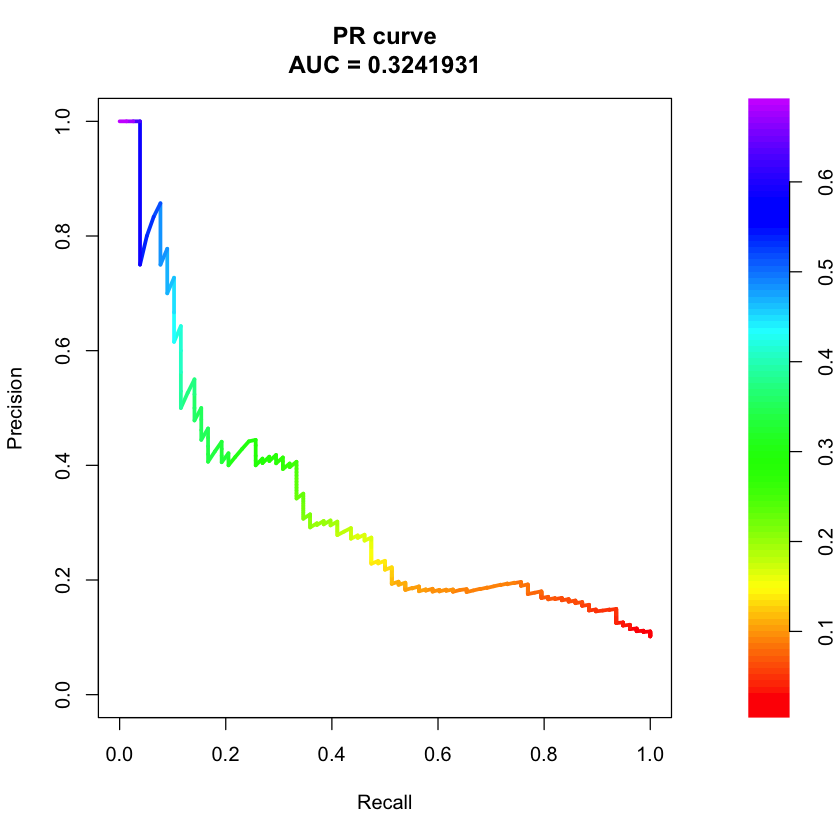

[1] 0.1000526


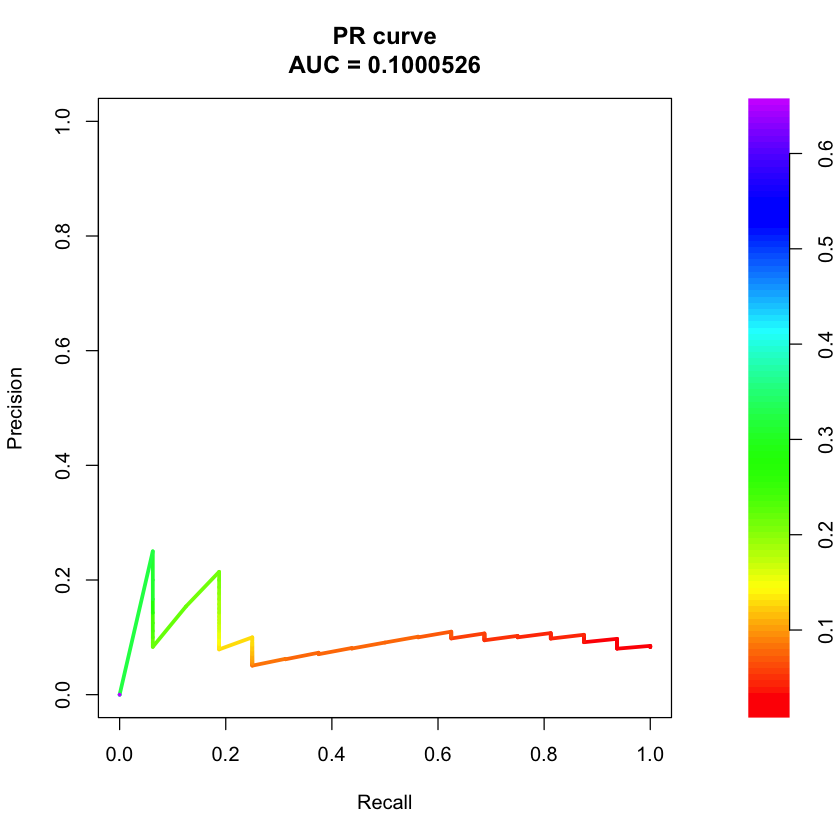

In [85]:
#print(actual_model)

for (i in 1:2) {
  dataset <- datas[[i]]
  probs <- predict(actual_model, newdata = dataset, type = "response") 
  true_labels <- dataset$target
  pr <- pr.curve(scores.class0 = probs[true_labels == 1],
               scores.class1 = probs[true_labels == 0],
               curve = TRUE)
  plot(pr)
  print(pr$auc.integral)
}

Setting levels: control = 0, case = 1

Setting direction: controls < cases



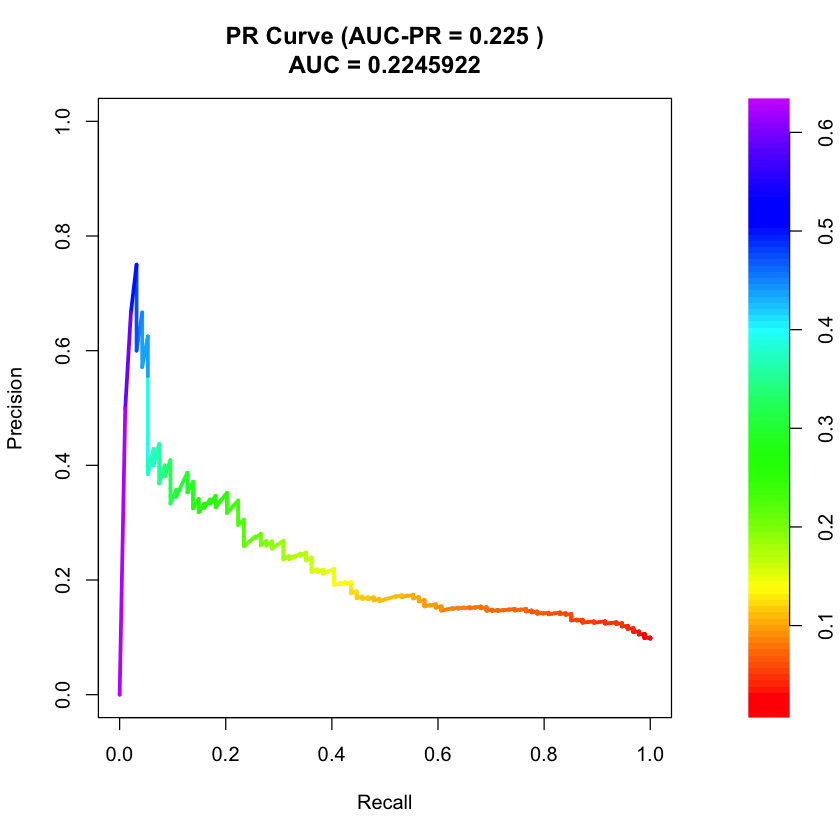

,AUC_ROC,AUC_PR,F1,Precision,Recall,Balanced_Accuracy
,<auc>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
F1,0.6989006,0.2245922,0.2550336,0.3454545,0.2021277,0.5803026


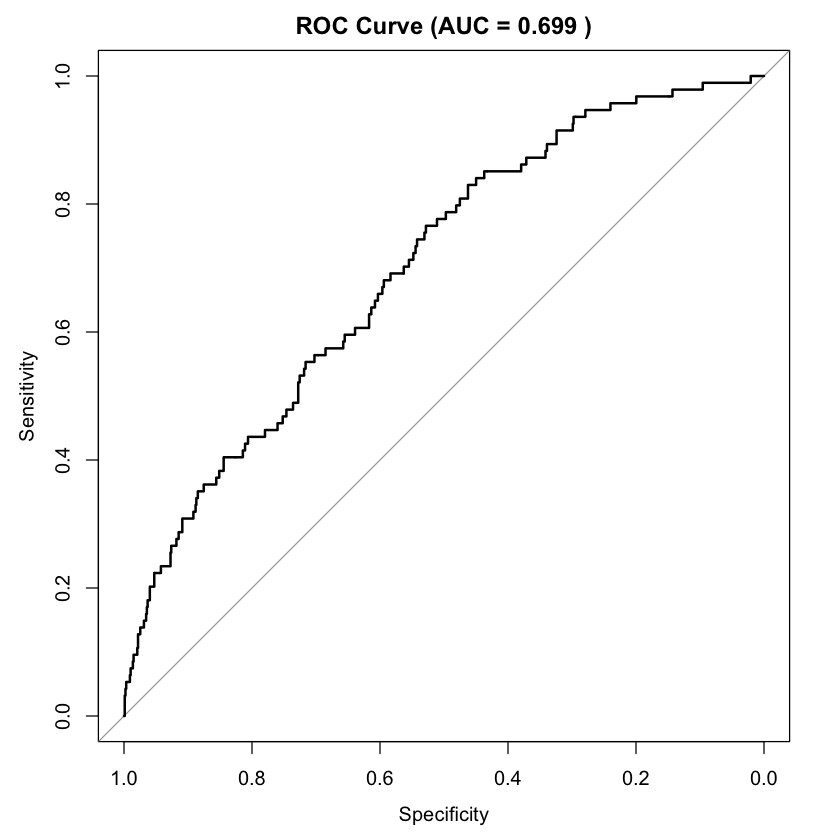

In [ ]:
#
# [1]"Signs of pulmonary venous hypertension (yes=1)"
# [2] "Q-waves (necrosis, yes=1)"                     
# [3] "Left atrial size (mm)"                         
# [4] "Calcium channel blocker (yes=1)"               
# [5] "Left ventricle end-diastolic diameter (mm)"    
#  "Current model AUCPRMeadian:  0.3244 [0.2208, 0.3940] AUCPRMean:  0.3263 (0.1312) \n |AIC: 408.7 [405.4777, 411.6246] |AUCRocMean: 0.7400 (0.0766)"


# Definir variáveis preditoras e target
predictors <- c(
  "Signs of pulmonary venous hypertension (yes=1)",
  "Q-waves (necrosis, yes=1)",
  "Left atrial size (mm)",
  "Calcium channel blocker (yes=1)",
  "Left ventricle end-diastolic diameter (mm)"
)
target <- "target"

# Garantir que o dataframe está correto
df <- df_end_imputed %>% 
  select(all_of(predictors), all_of(target)) %>%
  mutate(across(where(is.character), as.factor))  # Converter strings em fatores, se necessário

# Inicializar vetores para armazenar métricas
auc_pr_vec <- numeric(nrow(df))
f1_vec <- numeric(nrow(df))
recall_vec <- numeric(nrow(df))
precision_vec <- numeric(nrow(df))
balanced_accuracy_vec <- numeric(nrow(df))
all_probs <- numeric(nrow(df))
all_true <- numeric(nrow(df))

# Leave-One-Out Cross-Validation (LOOCV)
for (i in 1:nrow(df)) {
  # Dividir dados em treino (todos exceto i) e teste (apenas i)
  train_data <- df[-i, ]
  test_data <- df[i, ]
  
  # Treinar modelo de regressão logística
  model <- glm(
    formula = paste(target, "~ .") %>% as.formula(),
    data = train_data,
    family = binomial(link = "logit")
  )
  pred_prob <- predict(model, newdata = test_data, type = "response")
  all_probs[i] <- pred_prob
  all_true[i] <- test_data[[target]]
}

all_pred <- ifelse(all_probs > 0.25, 1, 0)
conf_mat <- caret::confusionMatrix(factor(all_pred, levels = c(0,1)),
                                    factor(all_true, levels = c(0,1)),
                                    positive = "1")

# Calcular métricas para a iteração atual
cm <- confusionMatrix(
  data = factor(pred_class, levels = c(0, 1)), 
  reference = factor(test_data[[target]], levels = c(0, 1)),
  positive = "1"
)

pr_obj <- pr.curve(
  scores.class0 = all_probs[all_true == 1],
  scores.class1 = all_probs[all_true == 0],
  curve = TRUE
)


plot(pr_obj, main = paste("PR Curve (AUC-PR =", round(pr_obj$auc.integral, 3), ")"))
roc_obj <- roc(all_true, all_probs)
plot(roc_obj, main = paste("ROC Curve (AUC =", round(auc(roc_obj), 3), ")"))

# Métricas finais:
metricsLoo <- data.frame(
  AUC_ROC = pROC::auc(roc_obj),
  AUC_PR = pr_obj$auc.integral,
  F1 = conf_mat$byClass["F1"],
  Precision = conf_mat$byClass["Precision"],
  Recall = conf_mat$byClass["Recall"],
  Balanced_Accuracy = conf_mat$byClass["Balanced Accuracy"]
)

metricsLoo


#### Backup manual modeling

In [ ]:
# # Required libraries
# library(pROC)
# options(pROC_quiet = TRUE)
# # Global structures
# variables_model <- list() # list of tuples (variable name, model)
# actual_model <- NULL      # current model
# history_stack <- list()   # to store history for undo


# # Function to create or update a glm model anr return it
# modelling_glm <- function(glm_model = NULL, actual_variable, var_target, dataset) {
#   # Protect variable names with backticks
#   protected_var <- paste0("`", actual_variable, "`")
#   model_output <- capture.output({
#     if (is.null(glm_model)) {
#       formula <- as.formula(paste(var_target, "~", protected_var))
#     } else {
#       old_vars <- all.vars(formula(glm_model))[-1] # exclude target
#       protected_old_vars <- paste0("`", old_vars, "`")
#       all_vars <- c(protected_old_vars, protected_var)
#       formula <- as.formula(paste(var_target, "~", paste(all_vars, collapse = "+")))
#     }
 
#     # Fit the new model
#     new_model <- glm(formula, data = dataset, family = "binomial")
#     return(new_model)
#    })

# }


# # Function to iterate over variables and create models
# iterate <- function(dataset, variables_in_model = NULL, actual_model = NULL) {
#   # Iterate over all columns in the dataset
#   for (var in names(dataset)) {
#     # Skip the target variable
#     if (var == var_target) next
#     # Skip variables already in model
#     if (var %in% variables_in_model) next
    
#     # Create a new model adding the current variable
#     new_model <- modelling_glm(actual_model, var, var_target, dataset)
    
#     # Append (variable name, model) to variables_model
#     variables_model[[length(variables_model) + 1]] <<- list(variable = var, model = new_model)
#   }
# }

# # Dataset to be used
# datasetModelling <- df_end_imputed
# var_target <- "target"
# selected_variables_order <- c()  # to keep track of chosen variables

# # Main interactive loop
# repeat {
#   if (length(variables_model) > 0) {
#     selected_var <- variables_model[[choice]]$variable
#     actual_model <- variables_model[[choice]]$model
#   } else {
#     actual_model <- iterate(datasetModelling)
#   }
#   history_stack[[length(history_stack) + 1]] <- list(actual_model = actual_model, variables_model = variables_model)
#   # Show variables and model statistics
#   print(length(variables_model))
#   if (length(variables_model) > 0) {
#     stats_list <- lapply(variables_model, function(item) {
#       model_summary <- summary(item$model)
#       coef_info <- coef(model_summary)
#       p_value <- coef_info[nrow(coef_info), "Pr(>|z|)"]
#       estimate <- coef_info[nrow(coef_info), "Estimate"]
#       std_error <- coef_info[nrow(coef_info), "Std. Error"]
#       ci_low <- estimate - 1.96 * std_error
#       ci_high <- estimate + 1.96 * std_error
#       aic <- AIC(item$model)
    
#       # Compute AUC-ROC
#       probs <- predict(item$model, type = "response")
#       auc <- auc(roc(datasetModelling[[var_target]], probs))
#       #formatting
#       p_value_formatted <- ifelse(round(p_value,4) < 0.0001, "< 0.0001", sprintf("%.4f", p_value))
#       ci_low_format <- ifelse(ci_low < 0.0001, "<0.0001", format(ci_low, digits = 4, nsmall = 4))
#       ci_high_format <- ifelse(ci_high < 0.0001, "<0.0001", format(ci_high, digits = 4, nsmall = 4))
#       ci95 <- (paste0("[", ci_low_format, ",", ci_high_format, "]"))
#       return(data.frame(
#         Variable = item$variable,
#         Coefficient = round(estimate, 4),
#         CI_95 = ci95,
#         P_value = p_value_formatted,
#         AIC = round(aic, 2),
#         AUC = round(auc, 4)
#       ))
#     }
#     )
    
    
#     stats_df <- do.call(rbind, stats_list)
#     stats_df <- stats_df[order(stats_df$AUC,decreasing = TRUE), ]
#     print(stats_df)
#   }
#   flush.console()
#   # Read user input
#   choice <- as.integer(readline("Please type the number of the variable you want to add next, 0 to exit, or -1 to undo last step:"))
#   print(choice)
#   if (choice == 0) {
#     cat("\nExiting the process.\n")
#     break
#   }
#   if (choice == -1) {
#     # Undo the last step
#     if (length(history_stack) == 0) {
#       cat("\nNothing to undo.\n")
#       next
#     } else {
#       last_state <- history_stack[[length(history_stack)]]
#       history_stack <- history_stack[-length(history_stack)] # pop the last state
#       actual_model <- last_state$actual_model
#       variables_model <- last_state$variables_model
#       cat("\nLast step undone.\n")
#       next
#     }
#   }
#   # Save the current state in history before changing
#   history_stack[[length(history_stack) + 1]] <- list(actual_model = actual_model, variables_model = variables_model)
#   # Reset variables_model and run iterate again
#   variables_model <- list()
#   model_vars <- all.vars(formula(actual_model))[-1] # get variables used
#   iterate(datasetModelling, model_vars, actual_model)

# }
# print(actual_model)
# cat("\nProcess finished. Final model selected.\n")

In [ ]:

# library(pROC)
# library(caret)
# options(pROC_quiet = TRUE)

# set.seed(42)

# # Metrics with K-fold Cross validations stratified
# metrics <- function(variables_model, dataset, var_target, n_folds = 10, n_repeats = 4) {

#   # aux funcion for calculate statistics of AUC-ROC and AIC obtained of CV
#   robust_stats <- function(x) {
#     q <- quantile(x, probs = c(0.25, 0.75), na.rm = TRUE)
#     list(
#       median = median(x, na.rm = TRUE),
#       iqr = sprintf("[%.4f, %.4f]", q[1], q[2]),
#       mean_sd = sprintf("%.4f (%.4f)", mean(x, na.rm = TRUE), sd(x, na.rm = TRUE)) 
#     )
#   }
#   # Loop over models
#   results <- lapply(seq_along(variables_model), function(i) {
#     item <- variables_model[[i]]
#     model <- item$model
#     variable <- item$variable
#     model_formula <- formula(model)
    
#     # Storage for CV metrics
#     auc_matrix <- matrix(nrow = n_repeats, ncol = n_folds)
#     aic_matrix <- matrix(nrow = n_repeats, ncol = n_folds)
    
#     for (r in 1:n_repeats) {
#       folds <- caret::createFolds(factor(dataset[[var_target]]), k = n_folds, list = TRUE)
#       for (f in 1:n_folds) {
#         train_data <- dataset[-folds[[f]], ]
#         test_data  <- dataset[folds[[f]], ]
        
#         fold_model <- glm(model_formula, data = train_data, family = "binomial")
#         aic_matrix[r, f] <- AIC(fold_model)
        
#         probs <- predict(fold_model, newdata = test_data, type = "response")
#         roc_obj <- pROC::roc(test_data[[var_target]], probs, quiet = TRUE)
#         auc_matrix[r, f] <- pROC::auc(roc_obj)
#       }
#     }
    
#     # Stats
#     auc_stats <- robust_stats(as.vector(auc_matrix))
#     aic_stats <- robust_stats(as.vector(aic_matrix))
    
#     # Coefficient info
#     coef_info <- coef(summary(model))
#     last_coef <- coef_info[nrow(coef_info), ]

#     estimate <- as.numeric(last_coef["Estimate"])
#     std_error <- as.numeric(last_coef["Std. Error"])
#     p_value <- as.numeric(last_coef["Pr(>|z|)"])
    
#     data.frame(
#       Variable = variable,
#       P_value = ifelse(p_value < 0.0001, "<0.0001", sprintf("%.4f", p_value)),
#       Estimate = round(estimate, 4),
#       Std.Error = sprintf("[%.4f]", std_error),
#       `AUC Roc Mean(SD)` = auc_stats$mean_sd,
#       `AIC Median[Q1-Q3]` = sprintf("%.1f %s", aic_stats$median, aic_stats$iqr),      
#       stringsAsFactors = FALSE
#     )
#   })

#   stats_df <- do.call(rbind, results)
#   stats_df <- stats_df[order(stats_df$AUC, decreasing = TRUE), ]
#   return(stats_df)
# }

# # Global structures
# variables_model <- list() # list of tuples (variable name, model)
# actual_model <- NULL      # current model
# history_stack <- list()   # to store history for undo

# # Function to create or update a glm model and return it
# modelling_glm <- function(glm_model = NULL, actual_variable, var_target, dataset) {
#   # Protect variable names with backticks
#   protected_var <- paste0("`", actual_variable, "`")
  
#   if (is.null(glm_model)) {
#     formula <- as.formula(paste(var_target, "~", protected_var))
#   } else {
#     old_vars <- all.vars(formula(glm_model))[-1] # exclude target
#     protected_old_vars <- paste0("`", old_vars, "`")
#     all_vars <- c(protected_old_vars, protected_var)
#     formula <- as.formula(paste(var_target, "~", paste(all_vars, collapse = "+")))
#   }
 
#   # Fit the new model
#   new_model <- glm(formula, data = dataset, family = "binomial")
#   return(new_model)
# }

# # Function to iterate over variables and create or update models
# iterate <- function(dataset, variables_in_model = NULL, actual_model = NULL) {
#   # Iterate over all columns in the dataset
#   for (var in names(dataset)) {
#     # Skip the target variable
#     if (var == var_target) next
#     # Skip variables already in model
#     if (var %in% variables_in_model) next
    
#     # Create a new model adding the current variable
#     new_model <- modelling_glm(actual_model, var, var_target, dataset)
    
#     # Append (variable name, model) to variables_model
#     variables_model[[length(variables_model) + 1]] <<- list(variable = var, model = new_model)
#   }
# }



## Automatic Modelling
#### - Stepwise and Lasso

Start:  AIC=497.8
target ~ 1

                                                   Df Deviance    AIC
+ `Left atrial size (mm)`                           1   472.22 476.22
+ `Left ventricle end-diastolic diameter (mm)`      1   482.83 486.83
+ `LVEF (%)`                                        1   485.49 489.49
+ `Pro-BNP (ng/L)`                                  1   486.61 490.61
+ `NYHA class`                                      1   486.68 490.68
+ `Ventricular Tachycardia`                         1   488.09 492.09
+ `Signs of pulmonary venous hypertension (yes=1)`  1   488.39 492.39
+ `Intraventricular conduction disorder`            1   488.91 492.91
+ `Right ventricle contractility (altered=1)`       1   489.03 493.03
+ `Q-waves (necrosis, yes=1)`                       1   489.13 493.13
+ `Spironolactone (yes=1)`                          1   490.46 494.46
+ `Creatinine (?mol/L)`                             1   491.67 495.67
+ `QRS duration (ms)`                               1   491.

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases



$stepwise_model

Call:  glm(formula = target ~ `Left atrial size (mm)` + `LVEF (%)` + 
    `Q-waves (necrosis, yes=1)` + `NYHA class` + `Calcium channel blocker (yes=1)` + 
    `Intraventricular conduction disorder`, family = "binomial", 
    data = train_data)

Coefficients:
                           (Intercept)                 `Left atrial size (mm)`  
                              -6.39461                                 0.06809  
                            `LVEF (%)`             `Q-waves (necrosis, yes=1)`  
                              -0.02706                                 0.65540  
                          `NYHA class`       `Calcium channel blocker (yes=1)`  
                               0.55804                                 0.68334  
`Intraventricular conduction disorder`  
                               0.09526  

Degrees of Freedom: 767 Total (i.e. Null);  761 Residual
Null Deviance:	    495.8 
Residual Deviance: 442.7 	AIC: 456.7

22 x 1 sparse Matrix of class "dg

,s1
(Intercept),-5.749604e+00
`Pro-BNP (ng/L)`,4.042754e-05
`Left atrial size (mm)`,4.855174e-02
`Left ventricle end-diastolic diameter (mm)`,5.486610e-03
`Creatinine (?mol/L)`,1.908807e-05
`QRS duration (ms)`,0.000000e+00
`QT corrected`,0.000000e+00
Age,0.000000e+00
`LVEF (%)`,-1.028083e-02
`Signs of pulmonary venous hypertension (yes=1)`,1.991684e-01


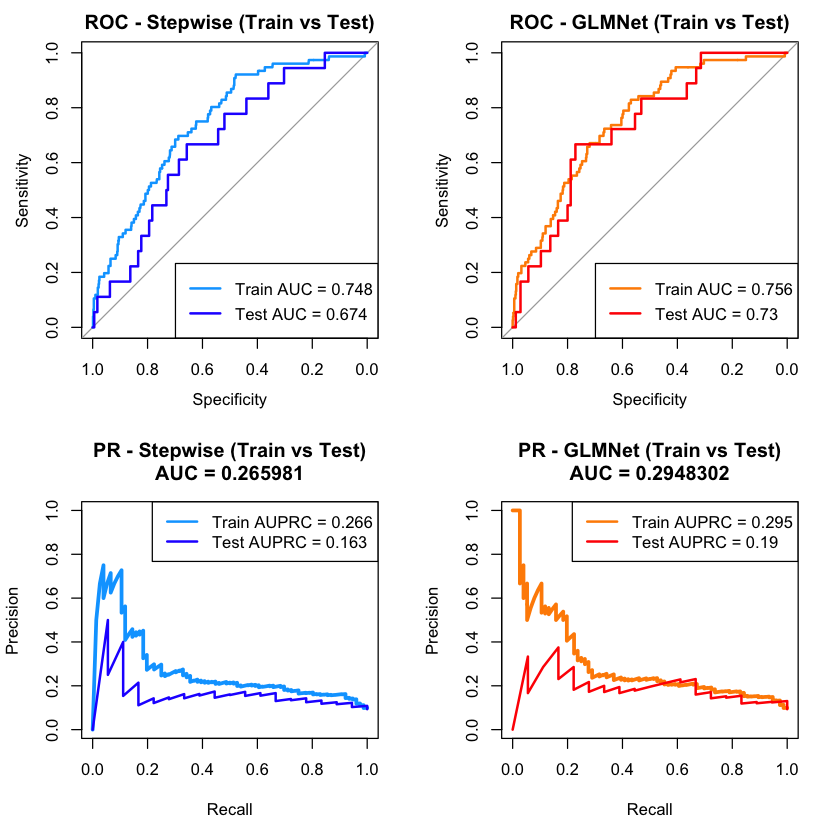

In [65]:
library(pROC)
options(pROC_quiet = TRUE)
library(caret)
library(glmnet)

set.seed(42)

#1.Dataset excluded NAS
df_end_variables_noNas <- na.omit(df_end_variables)
split_noNas <- initial_split(df_end_variables_noNas, prop = 0.8, strata = "target")
train_noNas <- training(split_noNas)
test_noNas <- testing(split_noNas)
#str(train_noNas)
y_test_noNas <- test_noNas$target
x_test_noNas <- test_noNas %>% select(-target)
y_train_noNas <- train_noNas$target
x_train_noNas <- train_noNas %>% select(-target)


#2 Dataset imputed
split_imputed <- initial_split(df_end_imputed, prop = 0.8, strata = "target")
train_imputed <- training(split_imputed)
test_imputed <- testing(split_imputed)
y_test_imputed <- test_imputed$target
x_test_imputed <- test_imputed %>% select(-target)
y_train_imputed <- train_imputed$target
x_train_imputed <- train_imputed %>% select(-target)



glm_auto <- function(x_train, y_train, x_test, y_test) {
 

  # Preparar datasets com a variável target
  train_data <- cbind(x_train, target = y_train)
  test_data <- cbind(x_test, target = y_test)
  
  

  #Stepwise
  modelo_inicial <- glm(target ~ 1, data = train_data, family = "binomial")
  modelo_completo <- glm(target ~ ., data = train_data, family = "binomial")
  modelo_stepwise <- stats::step(modelo_inicial, 
                          scope = list(lower = modelo_inicial, upper = modelo_completo), 
                          direction = "both")

  # GLMNET
  X_treino <- model.matrix(target ~ . - 1, data = train_data)
  modelo_glmnet <- cv.glmnet(X_treino, y_train, family = "binomial", alpha = 1)
  
  # Predições
  # ---- Stepwise
  probs_stepwise_train <- predict(modelo_stepwise, newdata = train_data, type = "response")
  probs_stepwise_test  <- predict(modelo_stepwise, newdata = test_data, type = "response")
  
  # ---- GLMNet
  X_teste <- model.matrix(target ~ . - 1, data = test_data)
  probs_glmnet_train <- predict(modelo_glmnet, newx = X_treino, type = "response", s = "lambda.min")
  probs_glmnet_test  <- predict(modelo_glmnet, newx = X_teste,  type = "response", s = "lambda.min")

  # Avaliação ROC
  roc_step_train <- roc(y_train, probs_stepwise_train)
  roc_step_test  <- roc(y_test,  probs_stepwise_test)
  roc_glm_train  <- roc(y_train, as.vector(probs_glmnet_train))
  roc_glm_test   <- roc(y_test,  as.vector(probs_glmnet_test))

  # Avaliação PR
  pr_step_train <- pr.curve(scores.class0 = probs_stepwise_train[y_train == 1],
                            scores.class1 = probs_stepwise_train[y_train == 0], curve = TRUE)
  pr_step_test  <- pr.curve(scores.class0 = probs_stepwise_test[y_test == 1],
                            scores.class1 = probs_stepwise_test[y_test == 0], curve = TRUE)

  pr_glm_train <- pr.curve(scores.class0 = probs_glmnet_train[y_train == 1],
                           scores.class1 = probs_glmnet_train[y_train == 0], curve = TRUE)
  pr_glm_test  <- pr.curve(scores.class0 = probs_glmnet_test[y_test == 1],
                           scores.class1 = probs_glmnet_test[y_test == 0], curve = TRUE)

  # Thresholds ideais (Youden) para métricas
  #th_step <- coords(roc_step_test, "best", best.method = "youden")
  #th_glm  <- coords(roc_glm_test,  "best", best.method = "youden")

  # Confusion matrices
  pred_step <- factor(ifelse(probs_stepwise_test > 0.1, 1, 0), levels = c(0, 1))
  pred_glm  <- factor(ifelse(probs_glmnet_test  > 0.1,1, 0), levels = c(0, 1))
  y_test_f  <- factor(y_test, levels = c(0, 1))

  cm_step <- confusionMatrix(pred_step, y_test_f, positive = "1")
  cm_glm  <- confusionMatrix(pred_glm,  y_test_f, positive = "1")

 par(mfrow = c(2, 2))

# ROC - Stepwise
plot(roc_step_train, col = "#00a6ff", lwd = 2, main = "ROC - Stepwise (Train vs Test)")
plot(roc_step_test, col = "#2600ff", lwd = 2, add = TRUE)
legend("bottomright", legend = c(
  paste("Train AUC =", round(auc(roc_step_train), 3)),
  paste("Test AUC =", round(auc(roc_step_test), 3))
), col = c("#00a6ff", "#2600ff"), lwd = 2)

# ROC - GLMNet
plot(roc_glm_train, col = "#FF8C00", lwd = 2, main = "ROC - GLMNet (Train vs Test)")
plot(roc_glm_test, col = "red", lwd = 2, add = TRUE)
legend("bottomright", legend = c(
  paste("Train AUC =", round(auc(roc_glm_train), 3)),
  paste("Test AUC =", round(auc(roc_glm_test), 3))
), col = c("#FF8C00", "red"), lwd = 2)

# PR - Stepwise
plot(pr_step_train, col = "#00a6ff", main = "PR - Stepwise (Train vs Test)", legend = FALSE)
plot(pr_step_test, col = "#2600ff", lwd = 2, add = TRUE)
legend("topright", legend = c(
  paste("Train AUPRC =", round(pr_step_train$auc.integral, 3)),
  paste("Test AUPRC =", round(pr_step_test$auc.integral, 3))
), col = c("#00a6ff", "#2600ff"), lwd = 2)

# PR - GLMNet
plot(pr_glm_train, col = "#FF8C00", main = "PR - GLMNet (Train vs Test)", legend = FALSE)
plot(pr_glm_test, col = "red", lwd = 2, add = TRUE)
legend("topright", legend = c(
  paste("Train AUPRC =", round(pr_glm_train$auc.integral, 3)),
  paste("Test AUPRC =", round(pr_glm_test$auc.integral, 3))
), col = c("#FF8C00", "red"), lwd = 2)

  # -------- Return --------
  return(list(
    stepwise_model = modelo_stepwise,
    glmnet_model = modelo_glmnet,
    confusion_matrices = list(stepwise = cm_step, glmnet = cm_glm),
    roc = list(stepwise = list(train = roc_step_train, test = roc_step_test),
               glmnet  = list(train = roc_glm_train,  test = roc_glm_test)),
    pr  = list(stepwise = list(train = pr_step_train, test = pr_step_test),
               glmnet  = list(train = pr_glm_train,  test = pr_glm_test))
  ))
}

models <- glm_auto(x_train_imputed, y_train_imputed, x_test_imputed, y_test_imputed)
#models <- glm_auto(x_train_noNas, y_train_noNas, x_test_noNas, y_test_noNas)
print(models[1])

print(coef(models[[2]], s = "lambda.min"))
as.matrix(coef(models[[2]], s = "lambda.min"))

#### backup automatic

In [ ]:

# library(pROC)
# options(pROC_quiet = TRUE)
# library(caret)
# library(glmnet)

# set.seed(42)
# # original dataset omitting NAs
# df_end_variables_noNas <- na.omit(df_end_variables)

# split_noNas <- initial_split(df_end_variables_noNas, prop = 0.8, strata = "target")

# train_noNas <- training(split_noNas)
# test_noNas <- testing(split_noNas)
# #str(train_noNas)
# yy_test_imputed <- test_imputed$target
# x_test_imputed <- test_imputed %>% select(-target)
# y_train_imputed <- train_imputed$target
# x_train_imputed <- train_imputed %>% select(-target)


# split_imputed <- initial_split(df_end_imputed, prop = 0.8, strata = "target")


# train_imputed <- training(split_imputed)
# test_imputed <- testing(split_imputed)

# y_test_noNas <- test_noNas$target
# x_test_noNas <- test_noNas %>% select(-target)
# y_train_noNas <- train_noNas$target
# x_train_noNas <- train_noNas %>% select(-target)

# #str(train_imputed)

# glm_auto <- function(x_train, y_train, x_test, y_test) { # x ~ dataset with target

#   # Stepwise
#   modelo_inicial <- glm(target ~ 1, data = x_train, family = "binomial")
#   modelo_completo <- glm(target ~ ., data = x_train, family = "binomial")
#   modelo_stepwise <- stats::step(modelo_inicial, scope = list(lower = modelo_inicial, upper = modelo_completo), direction = "both")
  
#   # GLMNET
#   X_treino <- model.matrix(target ~ . - 1, data = x_train)
#   y_treino <- y_train
#   modelo_glmnet <- cv.glmnet(X_treino, y_treino, family = "binomial", alpha = 1) # alpha=1 para LASSO
  
#   # Stepwise Predictions
#   probs_stepwise <- predict(modelo_stepwise, newdata = x_test, type = "response")
  
#   # GLMNET Predictions
#   X_teste <- model.matrix(target ~ . - 1, data = x_test)
#   probs_glmnet <- predict(modelo_glmnet, newx = X_teste, type = "response", s = "lambda.min")
  
#   # ROC curves
#   roc_stepwise <- roc(y_test, probs_stepwise)
#   roc_glmnet <- roc(y_test, as.vector(probs_glmnet))
  
#   # Espec and Sensibility
#   ths <- coords(roc_stepwise, "best", best.method = "youden")
#   preds_stepwise <- factor(ifelse(probs_stepwise > ths$threshold[1], 1, 0), levels = c(0, 1))
#   thg <- coords(roc_glmnet, "best", best.method = "youden")
#   preds_glmnet <- factor(ifelse(probs_glmnet > thg$threshold[1], 1, 0), levels = c(0, 1))
#   y_test <- factor(x_test$"target", levels = c(0, 1))  
  
#   cm_stepwise <- confusionMatrix(as.factor(preds_stepwise), as.factor(y_test), positive = "1")
#   cm_glmnet <- confusionMatrix(as.factor(preds_glmnet), as.factor(y_test), positive = "1")

#   sp_stepwise <- cm_stepwise$byClass["Specificity"]
#   sens_stepwise <- cm_stepwise$byClass["Sensitivity"]
  
#   sp_glmnet <- cm_glmnet$byClass["Specificity"]
#   sens_glmnet <- cm_glmnet$byClass["Sensitivity"]
#   # Para o modelo stepwise
#   pr_stepwise <- pr.curve(scores.class0 = probs_stepwise[y_test == 1], scores.class1 = probs_stepwise[y_test == 0], curve = TRUE)

#   # Para o modelo glmnet
#   pr_glmnet <- pr.curve(scores.class0 = as.vector(probs_glmnet)[y_test == 0], scores.class1 = as.vector(probs_glmnet)[y_test == 1], curve = TRUE)

#   # Para plotar as curvas
#   plot(pr_stepwise, main = paste0("Curva PR Stepwise (AUPRC = ", round(pr_stepwise$auc.integral, 4), ")"), col = "blue", legend = FALSE)
#   plot(pr_glmnet, main = paste0("Curva PR GLMnet (AUPRC = ", round(pr_glmnet$auc.integral, 4), ")"), col = "red", add = TRUE, legend = FALSE)
#   legend("topright", legend = c(paste0("Stepwise (AUPRC = ", round(pr_stepwise$auc.integral, 4), ")"),
#                            paste0("GLMnet (AUPRC = ", round(pr_glmnet$auc.integral, 4), ")")),
#        col = c("blue", "red"), lty = 1)
  
#   # Plot
#   plot(roc_stepwise, col = "blue", lwd = 2, main = "ROC Comparison - Stepwise vs GLMNet")
#   plot(roc_glmnet, col = "red", lwd = 2, add = TRUE)
#   library(PRROC)
#   legend("bottomright",
#          legend = c(paste0("Stepwise (AUC=", round(auc(roc_stepwise), 3),
#                            ", Espec=", round(sp_stepwise, 3),
#                            ", Sens=", round(sens_stepwise, 3), ")"),
#                     paste0("GLMNet (AUC=", round(auc(roc_glmnet), 3),
#                            ", Espec=", round(sp_glmnet, 3),
#                            ", Sens=", round(sens_glmnet, 3), ")")),
#          col = c("blue", "red"),
#          lwd = 2)
  
#   return(list(stepwise_model = modelo_stepwise, glmnet_model = modelo_glmnet))
# }

# models <- glm_auto(train_imputed,train_imputed$target,test_imputed,test_imputed$target)
# print(models[2])
# print(coef(models[2], s = "lambda.min"))
# as.matrix(coef(models[[2]], s = "lambda.min"))
# #models[1]
# print("predicts")
# #predict(models[1], newdata = test_imputed, type = "response") 

# true_labels <- test_imputed$target


# X_test<- model.matrix(target ~ . - 1, data = test_imputed)
# probs <- predict(models[[2]], newx = X_test, s = "lambda.min", type = "response")

# probs_vector <- probs





# # Construir e plotar a curva PR
# pr <- pr.curve(
#   scores.class0 = probs_vector[true_labels == 1],
#   scores.class1 = probs_vector[true_labels == 0],
#   curve = TRUE
# )

# plot(pr)
# print(pr$auc.integral)
# #predict(models[2], newdata = test_imputed, type = "response") 


# #models2<- glm_auto(train_noNas,train_noNas$target,test_noNas,test_noNas$target)
# #print(models[1])
